In [1]:
import torch
import torch.nn as nn
from torch._dynamo import OptimizedModule
from acvl_utils.cropping_and_padding.padding import pad_nd_image
from typing import Tuple, Union, List, Optional
import numpy as np
from tqdm import tqdm
import itertools

(155, 240, 240) 894.0 0.0 33.782722 79.42511 0.0 0.0
(155, 240, 240) 677.0 0.0 61.528088 138.27652 0.0 0.0
(155, 240, 240) 1443.0 0.0 68.42789 153.7961 0.0 0.0
(155, 240, 240) 500.0 0.0 24.852976 60.377518 0.0 0.0


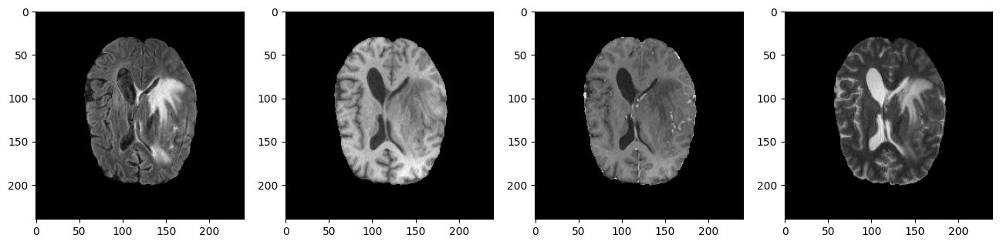

(155, 240, 240) 9.3515625 -3.208984375 0.009732550760911358 0.444373727648676 0.0 0.0
(155, 240, 240) 3.662109375 -3.763671875 0.004305050251271082 0.43515040757890644 0.0 0.0
(155, 240, 240) 10.9140625 -4.3125 0.007086164308391431 0.4370707092490881 0.0 0.0
(155, 240, 240) 6.0546875 -2.8359375 0.015984055054197123 0.45343088595692027 0.0 0.0


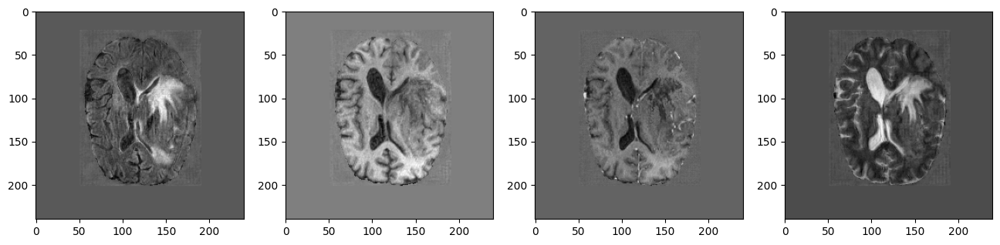

(155, 240, 240) 3 0 0.03604323476702509 0.27132472033620364 0.0 0.0
(155, 240, 240) 3 0 0.03186469534050179 0.2592519386892865 0.0 0.0
(155, 240, 240) 3 0 0.013162970430107527 0.13223086757065503 0.0 0.0
(155, 240, 240) 3 0 0.008360103046594982 0.0968621784605237 0.0 0.0
(155, 240, 240) 3 0 0.007552643369175627 0.09191238161178307 0.0 0.0
(155, 240, 240) 3 0 0.006402329749103943 0.08301150411455413 0.0 0.0


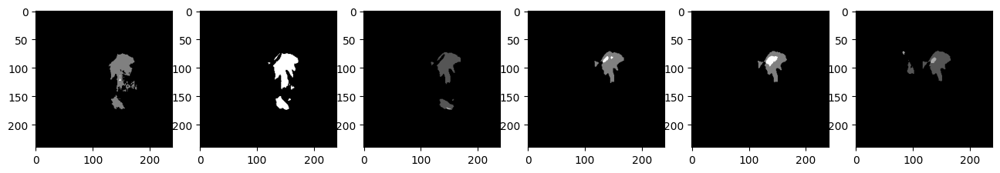

In [55]:
import SimpleITK as sitk
import matplotlib.pyplot as plt

%matplotlib inline

number = 314

# 读取nii.gz文件
file_path_list = [f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTs\\BRATS_{number}_0000.nii.gz', 
                  f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTs\\BRATS_{number}_0001.nii.gz', 
                  f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTs\\BRATS_{number}_0002.nii.gz', 
                  f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTs\\BRATS_{number}_0003.nii.gz']
file_path_label = [f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\labelsTs\\BRATS_{number}.nii.gz',
                   f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\inferTs\\BRATS_{number}.nii.gz',
                   f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\inferTs_pgd\\BRATS_{number}.nii.gz',
                   f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\inferTs_pgd_20\\BRATS_{number}.nii.gz',
                   f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\inferTs_pgd_30\\BRATS_{number}.nii.gz',
                   f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\inferTs_pgd_40\\BRATS_{number}.nii.gz']
file_path_pgd = [f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTs_pgd\\BRATS_{number}_0000.nii.gz', 
                  f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTs_pgd\\BRATS_{number}_0001.nii.gz', 
                  f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTs_pgd\\BRATS_{number}_0002.nii.gz', 
                  f'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTs_pgd\\BRATS_{number}_0003.nii.gz']


# 显示中间切片
def plot_middle_slice(file_path):
    if isinstance(file_path, list):
        channels = len(file_path)
        fig, ax = plt.subplots(1, channels, figsize=(16,16))
        
        for i, file in enumerate(file_path):
            img = sitk.ReadImage(file)
            data = sitk.GetArrayFromImage(img)
            print(data.shape, data.max(), data.min(), data.mean(), data.std(), np.percentile(data, 25), np.percentile(data, 75))
            middle_slice = data.shape[0] // 2
            ax[i].imshow(data[middle_slice, :, :], cmap='gray')
    else:
        img = sitk.ReadImage(file_path)
        data = sitk.GetArrayFromImage(img)
        print(data.shape, data.max(), data.min(), data.mean(), data.std())
        middle_slice = data.shape[0] // 2
        plt.imshow(data[middle_slice, :, :], cmap='gray')
        
    plt.show()

plot_middle_slice(file_path_list)
plot_middle_slice(file_path_pgd)
plot_middle_slice(file_path_label)

In [3]:
import os
from copy import deepcopy
from typing import Union, List

import numpy as np
import torch
from acvl_utils.cropping_and_padding.bounding_boxes import bounding_box_to_slice
from batchgenerators.utilities.file_and_folder_operations import load_json, isfile, save_pickle

from nnunetv2.configuration import default_num_processes
from nnunetv2.utilities.label_handling.label_handling import LabelManager
from nnunetv2.utilities.plans_handling.plans_handler import PlansManager, ConfigurationManager

def convert_predicted_logits_to_segmentation_with_correct_shape(predicted_logits: Union[torch.Tensor, np.ndarray],
                                                                plans_manager: PlansManager,
                                                                configuration_manager: ConfigurationManager,
                                                                label_manager: LabelManager,
                                                                properties_dict: dict,
                                                                return_probabilities: bool = False,
                                                                num_threads_torch: int = default_num_processes):
    old_threads = torch.get_num_threads()
    torch.set_num_threads(num_threads_torch)

    # resample to original shape
    current_spacing = configuration_manager.spacing if \
        len(configuration_manager.spacing) == \
        len(properties_dict['shape_after_cropping_and_before_resampling']) else \
        [properties_dict['spacing'][0], *configuration_manager.spacing]

    # print(f'current_spacing : {current_spacing}')
    # print(f'predicted_logits: {predicted_logits.shape}')
    predicted_logits = configuration_manager.resampling_fn_probabilities(predicted_logits,
                                            properties_dict['shape_after_cropping_and_before_resampling'],
                                            current_spacing,
                                            properties_dict['spacing'])
    # return value of resampling_fn_probabilities can be ndarray or Tensor but that does not matter because
    # apply_inference_nonlin will convert to torch
    print(f'after configuration: predicted_logits: {predicted_logits.shape}')
    predicted_probabilities = label_manager.apply_inference_nonlin(predicted_logits)
    print(f'predicted_probabilities: {predicted_probabilities.shape}')
    del predicted_logits
    segmentation = label_manager.convert_probabilities_to_segmentation(predicted_probabilities)
    # print(f'segmentation: {segmentation.shape}')

    # segmentation may be torch.Tensor but we continue with numpy
    if isinstance(segmentation, torch.Tensor):
        segmentation = segmentation.cpu().numpy()

    # put segmentation in bbox (revert cropping)
    segmentation_reverted_cropping = np.zeros(properties_dict['shape_before_cropping'],
                                              dtype=np.uint8 if len(label_manager.foreground_labels) < 255 else np.uint16)
    print(f'segmentation_reverted_cropping: {segmentation_reverted_cropping.shape}')
    slicer = bounding_box_to_slice(properties_dict['bbox_used_for_cropping'])
    segmentation_reverted_cropping[slicer] = segmentation
    del segmentation

    # revert transpose
    segmentation_reverted_cropping = segmentation_reverted_cropping.transpose(plans_manager.transpose_backward)
    print(f'segmentation_reverted_cropping: {segmentation_reverted_cropping.shape}')


    if return_probabilities:
        # revert cropping
        predicted_probabilities = label_manager.revert_cropping_on_probabilities(predicted_probabilities,
                                                                                 properties_dict[
                                                                                     'bbox_used_for_cropping'],
                                                                                 properties_dict[
                                                                                     'shape_before_cropping'])
        predicted_probabilities = predicted_probabilities.cpu().numpy()
        # revert transpose
        predicted_probabilities = predicted_probabilities.transpose([0] + [i + 1 for i in
                                                                           plans_manager.transpose_backward])
        torch.set_num_threads(old_threads)
        return segmentation_reverted_cropping, predicted_probabilities
    else:
        torch.set_num_threads(old_threads)
        return segmentation_reverted_cropping


def export_prediction_from_logits(predicted_array_or_file: Union[np.ndarray, torch.Tensor], properties_dict: dict,
                                  configuration_manager: ConfigurationManager,
                                  plans_manager: PlansManager,
                                  dataset_json_dict_or_file: Union[dict, str], output_file_truncated: str,
                                  save_probabilities: bool = False):
    # if isinstance(predicted_array_or_file, str):
    #     tmp = deepcopy(predicted_array_or_file)
    #     if predicted_array_or_file.endswith('.npy'):
    #         predicted_array_or_file = np.load(predicted_array_or_file)
    #     elif predicted_array_or_file.endswith('.npz'):
    #         predicted_array_or_file = np.load(predicted_array_or_file)['softmax']
    #     os.remove(tmp)

    if isinstance(dataset_json_dict_or_file, str):
        dataset_json_dict_or_file = load_json(dataset_json_dict_or_file)

    label_manager = plans_manager.get_label_manager(dataset_json_dict_or_file)
    
    
    rw = plans_manager.image_reader_writer_class()
    # print(f'Shape about to save {predicted_array_or_file.shape}')
    if predicted_array_or_file.ndim > 3:
        num_modalities = predicted_array_or_file.shape[0]
        # print(f'The number of modalities: {num_modalities}')
        
        for i in range(num_modalities):
            print(f'Now the modality number is {i}: {predicted_array_or_file[i].shape}')
            
            modality_data = predicted_array_or_file[i]
            
            
            if isinstance(modality_data, torch.Tensor):
                attacked_image = modality_data.cpu().numpy()
            else:
                attacked_image = modality_data

            rw.write_seg(attacked_image, output_file_truncated + f'_000{i}_b' + dataset_json_dict_or_file['file_ending'],
                properties_dict)

            print(f'Shape before convert: {attacked_image.shape}, {attacked_image.max()}, {attacked_image.min()}, {np.percentile(attacked_image, 25)}, {np.percentile(attacked_image, 75)}')
            # put segmentation in bbox (revert cropping)
            attacked_final = np.zeros(properties_dict['shape_before_cropping'])
            
            slicer = bounding_box_to_slice(properties_dict['bbox_used_for_cropping'])
            print(f'slicer is {slicer}')
            attacked_final[slicer] = attacked_image

            print(f'Shape right before writing: {attacked_final.shape}, {attacked_final.shape.max()},{attacked_final.min()}')
            
            rw.write_seg(attacked_final, output_file_truncated + f'_000{i}' + dataset_json_dict_or_file['file_ending'],
                         properties_dict)
            print(f'Finish writing the modality {i}')
        
        del predicted_array_or_file
    else:    
    
        ret = convert_predicted_logits_to_segmentation_with_correct_shape(
            predicted_array_or_file, plans_manager, configuration_manager, label_manager, properties_dict,
            return_probabilities=save_probabilities
        )
        del predicted_array_or_file
        
        segmentation_final = ret
        rw.write_seg(segmentation_final, output_file_truncated + dataset_json_dict_or_file['file_ending'],
                 properties_dict)

    # # save
    # if save_probabilities:
    #     segmentation_final, probabilities_final = ret
    #     np.savez_compressed(output_file_truncated + '.npz', probabilities=probabilities_final)
    #     save_pickle(properties_dict, output_file_truncated + '.pkl')
    #     del probabilities_final, ret
    # else:
    #     segmentation_final = ret
    #     del ret


def resample_and_save(predicted: Union[torch.Tensor, np.ndarray], target_shape: List[int], output_file: str,
                      plans_manager: PlansManager, configuration_manager: ConfigurationManager, properties_dict: dict,
                      dataset_json_dict_or_file: Union[dict, str], num_threads_torch: int = default_num_processes) \
        -> None:
    # # needed for cascade
    # if isinstance(predicted, str):
    #     assert isfile(predicted), "If isinstance(segmentation_softmax, str) then " \
    #                               "isfile(segmentation_softmax) must be True"
    #     del_file = deepcopy(predicted)
    #     predicted = np.load(predicted)
    #     os.remove(del_file)
    old_threads = torch.get_num_threads()
    torch.set_num_threads(num_threads_torch)

    if isinstance(dataset_json_dict_or_file, str):
        dataset_json_dict_or_file = load_json(dataset_json_dict_or_file)

    # resample to original shape
    current_spacing = configuration_manager.spacing if \
        len(configuration_manager.spacing) == len(properties_dict['shape_after_cropping_and_before_resampling']) else \
        [properties_dict['spacing'][0], *configuration_manager.spacing]
    target_spacing = configuration_manager.spacing if len(configuration_manager.spacing) == \
        len(properties_dict['shape_after_cropping_and_before_resampling']) else \
        [properties_dict['spacing'][0], *configuration_manager.spacing]
    predicted_array_or_file = configuration_manager.resampling_fn_probabilities(predicted,
                                                                                target_shape,
                                                                                current_spacing,
                                                                                target_spacing)

    # create segmentation (argmax, regions, etc)
    label_manager = plans_manager.get_label_manager(dataset_json_dict_or_file)
    segmentation = label_manager.convert_logits_to_segmentation(predicted_array_or_file)
    # segmentation may be torch.Tensor but we continue with numpy
    if isinstance(segmentation, torch.Tensor):
        segmentation = segmentation.cpu().numpy()
    np.savez_compressed(output_file, seg=segmentation.astype(np.uint8))
    torch.set_num_threads(old_threads)

torch.Size([4, 155, 240, 240])
torch.Size([155, 240, 240])


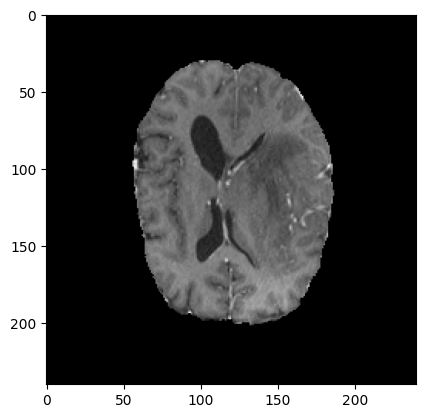

In [4]:
raw_1 = r'U:\YCZhang\Dissertation\data\.bash_history\BRATS_314.nii.gz'

def plot_middle_slice(file_path):
    if isinstance(file_path, list):
        channels = len(file_path)
        print(channels)
        fig, ax = plt.subplots(1, channels, figsize=(16,16))
        
        for i, file in enumerate(file_path):
            img = sitk.ReadImage(file)
            data = sitk.GetArrayFromImage(img)
            print(data.shape)
            middle_slice = data.shape[0] // 2
            ax[i].imshow(data[middle_slice, :, :], cmap='gray')
    else:
        img = sitk.ReadImage(file_path)
        data = sitk.GetArrayFromImage(img)
        data = torch.tensor(data)
        print(data.shape)
        data = data[2]
        print(data.shape)
        middle_slice = data.shape[0] // 2
        plt.imshow(data[middle_slice, :, :], cmap='gray')
        
    plt.show()

plot_middle_slice(raw_1)

In [5]:
import nnunetv2
from nnunetv2.configuration import default_num_processes
from nnunetv2.inference.data_iterators import PreprocessAdapterFromNpy, preprocessing_iterator_fromfiles, \
    preprocessing_iterator_fromnpy
from nnunetv2.inference.export_prediction import export_prediction_from_logits, \
    convert_predicted_logits_to_segmentation_with_correct_shape
from nnunetv2.inference.sliding_window_prediction import compute_gaussian, \
    compute_steps_for_sliding_window
from nnunetv2.utilities.file_path_utilities import get_output_folder, check_workers_alive_and_busy
from nnunetv2.utilities.find_class_by_name import recursive_find_python_class
from nnunetv2.utilities.helpers import empty_cache, dummy_context
from nnunetv2.utilities.json_export import recursive_fix_for_json_export
from nnunetv2.utilities.label_handling.label_handling import determine_num_input_channels, LabelManager
from nnunetv2.utilities.plans_handling.plans_handler import PlansManager, ConfigurationManager
from nnunetv2.utilities.utils import create_lists_from_splitted_dataset_folder


nnUNet_raw is not defined and nnU-Net can only be used on data for which preprocessed files are already present on your system. nnU-Net cannot be used for experiment planning and preprocessing like this. If this is not intended, please read documentation/setting_up_paths.md for information on how to set this up properly.
nnUNet_preprocessed is not defined and nnU-Net can not be used for preprocessing or training. If this is not intended, please read documentation/setting_up_paths.md for information on how to set this up.
nnUNet_results is not defined and nnU-Net cannot be used for training or inference. If this is not intended behavior, please read documentation/setting_up_paths.md for information on how to set this up.


In [6]:
import os
import json
from batchgenerators.utilities.file_and_folder_operations import join, save_pickle
from nnunetv2.imageio.simpleitk_reader_writer import SimpleITKIO

In [7]:
def load_json(file: str):
    with open(file, 'r') as f:
        a = json.load(f)
    return a

In [8]:
sample = {"Dice": 0.7513787052704143,
                    "FN": 22731,
                    "FP": 9007,
                    "IoU": 0.6017666913434634,
                    "TN": 8848303,
                    "TP": 47959,
                    "n_pred": 56966,
                    "n_ref": 70690
        }

In [9]:
tp = sample['TP']
fp = sample['FP']
fn = sample['FN']

dice = 2 * tp / (2 * tp + fp + fn)
iou = tp / (tp + fp + fn)
dice, iou

(0.7513787052704143, 0.6017666913434634)

In [10]:
print(torch.__version__)

2.3.0+cpu


In [11]:
checkpoint = torch.load(r'U:\YCZhang\Dissertation\data\.bash_history\checkpoint_final.pth',
                                    map_location=torch.device('cpu'))

In [12]:
print(checkpoint.keys())
parameters = []
trainer_name = checkpoint['trainer_name']
configuration_name = checkpoint['init_args']['configuration']
inference_allowed_mirroring_axes = checkpoint['inference_allowed_mirroring_axes'] if \
    'inference_allowed_mirroring_axes' in checkpoint.keys() else None

parameters.append(checkpoint['network_weights'])
trainer_name, configuration_name, inference_allowed_mirroring_axes

dict_keys(['network_weights', 'optimizer_state', 'grad_scaler_state', 'logging', '_best_ema', 'current_epoch', 'init_args', 'trainer_name', 'inference_allowed_mirroring_axes'])


('nnUNetTrainer', '3d_fullres', (0, 1, 2))

In [13]:
parameters[0]

OrderedDict([('encoder.stages.0.0.convs.0.conv.weight',
              tensor([[[[[-2.3958e-01, -1.6511e-01, -1.0379e-01],
                         [-7.0482e-02,  3.7424e-02, -1.2789e-01],
                         [-2.2990e-01, -1.2281e-01, -1.6330e-01]],
              
                        [[-2.6912e-02,  7.9027e-02, -3.5711e-02],
                         [ 2.8798e-01,  4.7476e-01,  2.2895e-02],
                         [ 5.2911e-02,  2.2778e-01, -4.4950e-02]],
              
                        [[-4.1482e-02,  1.0874e-01, -6.6427e-02],
                         [ 3.2906e-01,  5.6155e-01,  2.5577e-02],
                         [ 4.4161e-02,  2.5965e-01, -7.6940e-02]]],
              
              
                       [[[-8.0405e-02, -2.6616e-02,  6.4820e-03],
                         [-7.0180e-02, -3.2783e-02, -1.8682e-02],
                         [-7.2745e-02, -4.6140e-02, -2.0794e-02]],
              
                        [[-4.8239e-02,  1.5740e-02,  2.8302e-02],
      

In [14]:
for params, value in parameters[0].items():
    print(params, value.shape)

encoder.stages.0.0.convs.0.conv.weight torch.Size([32, 4, 3, 3, 3])
encoder.stages.0.0.convs.0.conv.bias torch.Size([32])
encoder.stages.0.0.convs.0.norm.weight torch.Size([32])
encoder.stages.0.0.convs.0.norm.bias torch.Size([32])
encoder.stages.0.0.convs.0.all_modules.0.weight torch.Size([32, 4, 3, 3, 3])
encoder.stages.0.0.convs.0.all_modules.0.bias torch.Size([32])
encoder.stages.0.0.convs.0.all_modules.1.weight torch.Size([32])
encoder.stages.0.0.convs.0.all_modules.1.bias torch.Size([32])
encoder.stages.0.0.convs.1.conv.weight torch.Size([32, 32, 3, 3, 3])
encoder.stages.0.0.convs.1.conv.bias torch.Size([32])
encoder.stages.0.0.convs.1.norm.weight torch.Size([32])
encoder.stages.0.0.convs.1.norm.bias torch.Size([32])
encoder.stages.0.0.convs.1.all_modules.0.weight torch.Size([32, 32, 3, 3, 3])
encoder.stages.0.0.convs.1.all_modules.0.bias torch.Size([32])
encoder.stages.0.0.convs.1.all_modules.1.weight torch.Size([32])
encoder.stages.0.0.convs.1.all_modules.1.bias torch.Size([32]

In [15]:
input_path = r'U:\YCZhang\Dissertation\data\.bash_history\imagesTr'
label_path = r'U:\YCZhang\Dissertation\data\.bash_history\labelsTr'

dataset_json = load_json(r'U:\YCZhang\Dissertation\data\.bash_history\dataset.json')
plans = load_json(r'U:\YCZhang\Dissertation\data\.bash_history\plans.json')

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
verbose = True
tile_step_size = 0.5
plans_manager = PlansManager(plans)
configuration_manager = plans_manager.get_configuration(configuration_name=configuration_name)
label_manager = plans_manager.get_label_manager(dataset_json)
num_input_channels = determine_num_input_channels(plans_manager, configuration_manager, dataset_json)
trainer_class = recursive_find_python_class(join(nnunetv2.__path__[0], "training", "nnUNetTrainer"),
                                                    trainer_name, 'nnunetv2.training.nnUNetTrainer')
num_input_channels, label_manager, trainer_class

(4,
 nnunetv2.training.nnUNetTrainer.nnUNetTrainer.nnUNetTrainer)

In [16]:
network = trainer_class.build_network_architecture(
            configuration_manager.network_arch_class_name,
            configuration_manager.network_arch_init_kwargs,
            configuration_manager.network_arch_init_kwargs_req_import,
            num_input_channels,
            plans_manager.get_label_manager(dataset_json).num_segmentation_heads,
            enable_deep_supervision=False
        )
if ('nnUNet_compile' in os.environ.keys()) and (os.environ['nnUNet_compile'].lower() in ('true', '1', 't')) \
        and not isinstance(network, OptimizedModule):
    print('Using torch.compile')
    network = torch.compile(network)
    
network

PlainConvUNet(
  (encoder): PlainConvEncoder(
    (stages): Sequential(
      (0): Sequential(
        (0): StackedConvBlocks(
          (convs): Sequential(
            (0): ConvDropoutNormReLU(
              (conv): Conv3d(4, 32, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
              (norm): InstanceNorm3d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
              (nonlin): LeakyReLU(negative_slope=0.01, inplace=True)
              (all_modules): Sequential(
                (0): Conv3d(4, 32, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
                (1): InstanceNorm3d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
                (2): LeakyReLU(negative_slope=0.01, inplace=True)
              )
            )
            (1): ConvDropoutNormReLU(
              (conv): Conv3d(32, 32, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1))
              (norm): InstanceNorm3d(32, eps=1e-05, momentum=

In [17]:
for params in parameters:
    print(params)
    if not isinstance(network, OptimizedModule):
        network.load_state_dict(params)
    else:
        network._orig_mod.load_state_dict(params)

OrderedDict([('encoder.stages.0.0.convs.0.conv.weight', tensor([[[[[-2.3958e-01, -1.6511e-01, -1.0379e-01],
           [-7.0482e-02,  3.7424e-02, -1.2789e-01],
           [-2.2990e-01, -1.2281e-01, -1.6330e-01]],

          [[-2.6912e-02,  7.9027e-02, -3.5711e-02],
           [ 2.8798e-01,  4.7476e-01,  2.2895e-02],
           [ 5.2911e-02,  2.2778e-01, -4.4950e-02]],

          [[-4.1482e-02,  1.0874e-01, -6.6427e-02],
           [ 3.2906e-01,  5.6155e-01,  2.5577e-02],
           [ 4.4161e-02,  2.5965e-01, -7.6940e-02]]],


         [[[-8.0405e-02, -2.6616e-02,  6.4820e-03],
           [-7.0180e-02, -3.2783e-02, -1.8682e-02],
           [-7.2745e-02, -4.6140e-02, -2.0794e-02]],

          [[-4.8239e-02,  1.5740e-02,  2.8302e-02],
           [-4.1976e-02,  1.7406e-02,  9.8906e-03],
           [-5.4538e-02, -1.5389e-02, -7.0271e-03]],

          [[-3.1055e-03,  4.7195e-02,  6.1324e-02],
           [-1.3647e-02,  4.4767e-02,  5.1172e-02],
           [-2.0751e-02,  1.8386e-02,  3.6855e-0

In [18]:
print(
    "Number of total parameters: ",
    sum(p.numel() for _, p in parameters[0].items()),
)  # 88632372

Number of total parameters:  88632372


In [19]:
configuration_manager.patch_size, len(configuration_manager.patch_size)

([128, 128, 128], 3)

In [20]:
def _internal_get_sliding_window_slicers(image_size: Tuple[int, ...]):
    """Get sliding windows for given image_size"""

    slicers = []
    if len(configuration_manager.patch_size) < len(image_size):
        assert len(configuration_manager.patch_size) == len(
            image_size) - 1, 'if tile_size has less entries than image_size, ' \
                                'len(tile_size) ' \
                                'must be one shorter than len(image_size) ' \
                                '(only dimension ' \
                                'discrepancy of 1 allowed).'
        steps = compute_steps_for_sliding_window(image_size[1:], configuration_manager.patch_size,
                                                    tile_step_size)
        if verbose: print(f'n_steps {image_size[0] * len(steps[0]) * len(steps[1])}, image size is'
                                f' {image_size}, tile_size {configuration_manager.patch_size}, '
                                f'tile_step_size {tile_step_size}\nsteps:\n{steps}')
        for d in range(image_size[0]):
            for sx in steps[0]:
                for sy in steps[1]:
                    slicers.append(
                        tuple([slice(None), d, *[slice(si, si + ti) for si, ti in
                                                    zip((sx, sy), configuration_manager.patch_size)]]))
    else:
        steps = compute_steps_for_sliding_window(image_size, configuration_manager.patch_size,
                                                    tile_step_size)
        if verbose: print(
            f'n_steps {np.prod([len(i) for i in steps])}, image size is {image_size}, tile_size {configuration_manager.patch_size}, '
            f'tile_step_size {tile_step_size}\nsteps:\n{steps}')
        for sx in steps[0]:
            for sy in steps[1]:
                for sz in steps[2]:
                    slicers.append(
                        tuple([slice(None), *[slice(si, si + ti) for si, ti in
                                                zip((sx, sy, sz), configuration_manager.patch_size)]]))
    return slicers

In [21]:
def pgd_attack(model, images, labels, eps=0.1, alpha=2/255, iters=10):
    images = images.to(device)
    labels = torch.squeeze(labels, dim=1)
    labels = labels.to(device)

    loss = nn.CrossEntropyLoss()
        
    ori_images = images.data
    print(ori_images.shape)
    plt.imshow(ori_images[64, :, :], cmap='gray')
        
    for i in range(iters) :    
        images.requires_grad = True
        outputs = model(images)

        model.zero_grad()
        cost = loss(outputs, labels).to(device)
        print(cost)
        cost.backward()

        adv_images = images + alpha*images.grad.sign()
        eta = torch.clamp(adv_images - ori_images, min=-eps, max=eps)
        images = torch.clamp(ori_images + eta, min=0, max=1).detach_()

        plt.imshow(images[64, :, :], cmap='gray')
            
    return images

In [22]:
def _internal_maybe_mirror_and_predict(x: torch.Tensor, y: torch.Tensor) -> torch.Tensor:
    """The function to predict"""
    prediction = pgd_attack(network, x, y)
    return prediction

In [23]:
label_manager.num_segmentation_heads

4

In [24]:
def export_prediction_from_logits(predicted_array_or_file: Union[np.ndarray, torch.Tensor], properties_dict: dict,
                                  configuration_manager: ConfigurationManager,
                                  plans_manager: PlansManager,
                                  dataset_json_dict_or_file: Union[dict, str], output_file_truncated: str,
                                  save_probabilities: bool = False):
    # if isinstance(predicted_array_or_file, str):
    #     tmp = deepcopy(predicted_array_or_file)
    #     if predicted_array_or_file.endswith('.npy'):
    #         predicted_array_or_file = np.load(predicted_array_or_file)
    #     elif predicted_array_or_file.endswith('.npz'):
    #         predicted_array_or_file = np.load(predicted_array_or_file)['softmax']
    #     os.remove(tmp)

    if isinstance(dataset_json_dict_or_file, str):
        dataset_json_dict_or_file = load_json(dataset_json_dict_or_file)

    label_manager = plans_manager.get_label_manager(dataset_json_dict_or_file)
    ret = convert_predicted_logits_to_segmentation_with_correct_shape(
        predicted_array_or_file, plans_manager, configuration_manager, label_manager, properties_dict,
        return_probabilities=save_probabilities
    )
    del predicted_array_or_file

    # save
    if save_probabilities:
        segmentation_final, probabilities_final = ret
        np.savez_compressed(output_file_truncated + '.npz', probabilities=probabilities_final)
        save_pickle(properties_dict, output_file_truncated + '.pkl')
        del probabilities_final, ret
    else:
        segmentation_final = ret
        del ret

    print(segmentation_final.shape)

    rw = plans_manager.image_reader_writer_class()
    rw.write_seg(segmentation_final, output_file_truncated + dataset_json_dict_or_file['file_ending'],
                 properties_dict)

In [25]:
def _internal_predict_sliding_window_return_logits(data: torch.Tensor, label: torch.Tensor, slicers, do_on_device: bool = True):
    """internal part of main function for process of prediction"""
    predicted_logits = n_predictions = prediction = gaussian = workon = None
    use_gaussian = True
    allow_tqdm = True

    if not torch.cuda.is_available():
        do_on_device = False
    else:
        pass
    
    results_device = device if do_on_device else torch.device('cpu')

    try:
        empty_cache(device)

        # move data to device
        if verbose:
            print(f'move image to device {results_device}')
        data = data.to(results_device)

        # preallocate arrays
        if verbose:
            print(f'preallocating results arrays on device {results_device}')
        predicted_logits = torch.zeros((label_manager.num_segmentation_heads, *data.shape[1:]),
                                        dtype=torch.half,
                                        device=results_device)
        n_predictions = torch.zeros(data.shape[1:], dtype=torch.half, device=results_device)

        if use_gaussian:
            gaussian = compute_gaussian(tuple(configuration_manager.patch_size), sigma_scale=1. / 8,
                                        value_scaling_factor=10,
                                        device=results_device)
        else:
            gaussian = 1

        if not allow_tqdm and verbose:
            print(f'running prediction: {len(slicers)} steps')
        for sl in tqdm(slicers, disable=not allow_tqdm):
            workon, label_on = data[sl][None], label[sl][None]
            workon = workon.to(device)
            label_on = label_on.to(device)
            print(workon.shape, label_on.shape)

            prediction = _internal_maybe_mirror_and_predict(workon, label_on)[0].to(results_device)

            if use_gaussian:
                prediction *= gaussian
            predicted_logits[sl] += prediction
            n_predictions[sl[1:]] += gaussian

        predicted_logits /= n_predictions
        # check for infs
        if torch.any(torch.isinf(predicted_logits)):
            raise RuntimeError('Encountered inf in predicted array. Aborting... If this problem persists, '
                                'reduce value_scaling_factor in compute_gaussian or increase the dtype of '
                                'predicted_logits to fp32')
    except Exception as e:
        del predicted_logits, n_predictions, prediction, gaussian, workon
        empty_cache(device)
        empty_cache(results_device)
        raise e
    return predicted_logits

In [26]:
def predict_sliding_window_return_logits(input_image: torch.Tensor, input_label: torch.Tensor, network, verbose = True) -> Union[np.ndarray, torch.Tensor]:
    """main function for process of prediction"""

    assert isinstance(input_image, torch.Tensor)

    network = network.to(device)
    network.eval()

    if torch.cuda.is_available():
        perform_everything_on_device = True
    else:
        perform_everything_on_device = False

    empty_cache(device)

    assert input_image.ndim == 4, 'input_image must be a 4D np.ndarray or torch.Tensor (c, x, y, z)'

    if verbose: 
        print(f'Input image shape: {input_image.shape}')
        print(f'Input label shape: {input_label.shape}')
        print("step_size:", tile_step_size)
        # print("mirror_axes:", allowed_mirroring_axes if use_mirroring else None)

    # if input_image is smaller than tile_size we need to pad it to tile_size.
    data, slicer_revert_padding = pad_nd_image(input_image, configuration_manager.patch_size,
                                                'constant', {'value': 0}, True,
                                                None)
    
    # I assume that the padding function will make same padding for image and label with same shape
    label, _ = pad_nd_image(input_label, configuration_manager.patch_size,
                                                'constant', {'value': 0}, True,
                                                None)

    slicers = _internal_get_sliding_window_slicers(data.shape[1:])

    if perform_everything_on_device and device != 'cpu':
        # we need to try except here because we can run OOM in which case we need to fall back to CPU as a results device
        try:
            predicted_logits = _internal_predict_sliding_window_return_logits(data, label, slicers,
                                                                                    perform_everything_on_device)
        except RuntimeError:
            print(
                'Prediction on device was unsuccessful, probably due to a lack of memory. Moving results arrays to CPU')
            empty_cache(device)
            predicted_logits = _internal_predict_sliding_window_return_logits(data, label, slicers, False)
    else:
        predicted_logits = _internal_predict_sliding_window_return_logits(data, label, slicers,
                                                                                perform_everything_on_device)

    empty_cache(device)
    # revert padding
    predicted_logits = predicted_logits[(slice(None), *slicer_revert_padding[1:])]
    return predicted_logits

In [27]:
list_of_lists_or_source_folder = input_path
if isinstance(list_of_lists_or_source_folder, str):
    list_of_lists_or_source_folder = create_lists_from_splitted_dataset_folder(list_of_lists_or_source_folder, dataset_json['file_ending'])

list_of_lists_or_source_folder

[['U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_001_0000.nii.gz',
  'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_001_0001.nii.gz',
  'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_001_0002.nii.gz',
  'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_001_0003.nii.gz'],
 ['U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_002_0000.nii.gz',
  'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_002_0001.nii.gz',
  'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_002_0002.nii.gz',
  'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_002_0003.nii.gz'],
 ['U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_003_0000.nii.gz',
  'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_003_0001.nii.gz',
  'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_003_0002.nii.gz',
  'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BR

In [28]:
plans_manager.transpose_forward, plans_manager.image_reader_writer_class()

([0, 1, 2],
 <nnunetv2.imageio.simpleitk_reader_writer.SimpleITKIO at 0x21672921ed0>)

In [29]:
configuration_manager.patch_size

[128, 128, 128]

In [30]:
import numpy as np
from scipy.ndimage import binary_fill_holes

# Hello! crop_to_nonzero is the function you are looking for. Ignore the rest.
from acvl_utils.cropping_and_padding.bounding_boxes import get_bbox_from_mask, crop_to_bbox, bounding_box_to_slice


def create_nonzero_mask(data):
    """

    :param data:
    :return: the mask is True where the data is nonzero
    """
    assert data.ndim in (3, 4), "data must have shape (C, X, Y, Z) or shape (C, X, Y)"
    nonzero_mask = data[0] != 0
    for c in range(1, data.shape[0]):
        nonzero_mask |= data[c] != 0
    return binary_fill_holes(nonzero_mask)


def crop_to_nonzero(data, seg=None, nonzero_label=-1):
    """

    :param data:
    :param seg:
    :param nonzero_label: this will be written into the segmentation map
    :return:
    """
    nonzero_mask = create_nonzero_mask(data)
    bbox = get_bbox_from_mask(nonzero_mask)
    slicer = bounding_box_to_slice(bbox)
    nonzero_mask = nonzero_mask[slicer][None]
    
    slicer = (slice(None), ) + slicer
    data = data[slicer]
    if seg is not None:
        seg = seg[slicer]
        seg[(seg == 0) & (~nonzero_mask)] = nonzero_label
    else:
        seg = np.where(nonzero_mask, np.int8(0), np.int8(nonzero_label))
    return data, seg, bbox

In [31]:
def _normalize(self, data: np.ndarray, seg: np.ndarray, configuration_manager: ConfigurationManager,
                   foreground_intensity_properties_per_channel: dict) -> np.ndarray:
        print(f'Before normalization: {data.shape}')
        for c in range(data.shape[0]):
            scheme = configuration_manager.normalization_schemes[c]
            normalizer_class = recursive_find_python_class(join(nnunetv2.__path__[0], "preprocessing", "normalization"),
                                                           scheme,
                                                           'nnunetv2.preprocessing.normalization')
            if normalizer_class is None:
                raise RuntimeError(f'Unable to locate class \'{scheme}\' for normalization')
            normalizer = normalizer_class(use_mask_for_norm=configuration_manager.use_mask_for_norm[c],
                                          intensityproperties=foreground_intensity_properties_per_channel[str(c)])
            data[c] = normalizer.run(data[c], seg[0])
        return data

In [32]:
preprocessor = configuration_manager.preprocessor_class(verbose=True)

data, seg, data_properties = preprocessor.run_case(list_of_lists_or_source_folder[0],
                                                            None,
                                                            plans_manager,
                                                            configuration_manager,
                                                            dataset_json)
# rw = plans_manager.image_reader_writer_class()
# data, data_properties = rw.read_images(list_of_lists_or_source_folder[0])

print(1, data.shape, data.mean(), data.std(), data.max(), data.min())
data = torch.from_numpy(data).to(dtype=torch.float32, memory_format=torch.contiguous_format)

data, slicer_revert_padding = pad_nd_image(data, configuration_manager.patch_size,
                                                'constant', {'value': 0}, True,
                                                None)
print(2, data.shape)
slicers = _internal_get_sliding_window_slicers(data.shape[1:])
sl = slicers[0]
workon = data[sl][None]
workon.requires_grad = True
print(3, sl, workon.shape)

prediction = network(workon)
print(f'Prediction shape is {prediction.shape}')

Hello, (4, 155, 240, 240)
2 Hello, (4, 155, 240, 240)
(4, 132, 176, 136) (1, 132, 176, 136)
Before normalization: (4, 132, 176, 136)
current shape (132, 176, 136) current_spacing [1.0, 1.0, 1.0] 
target shape [132 176 136] target_spacing [1.0, 1.0, 1.0]
old shape: (132, 176, 136), new_shape: [132 176 136], old_spacing: [1.0, 1.0, 1.0], new_spacing: [1.0, 1.0, 1.0], fn_data: functools.partial(<function resample_data_or_seg_to_shape at 0x00000216798F3060>, is_seg=False, order=3, order_z=0, force_separate_z=None)
1 (4, 132, 176, 136) 2.1674899e-07 0.6879213 6.4906454 -3.6622622
2 torch.Size([4, 132, 176, 136])
n_steps 8, image size is torch.Size([132, 176, 136]), tile_size [128, 128, 128], tile_step_size 0.5
steps:
[[0, 4], [0, 48], [0, 8]]
3 (slice(None, None, None), slice(0, 128, None), slice(0, 128, None), slice(0, 128, None)) torch.Size([1, 4, 128, 128, 128])
Prediction shape is torch.Size([1, 4, 128, 128, 128])


In [33]:
data_properties

{'sitk_stuff': {'spacing': (1.0, 1.0, 1.0),
  'origin': (0.0, 0.0, 0.0),
  'direction': (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)},
 'spacing': [1.0, 1.0, 1.0],
 'shape_before_cropping': (155, 240, 240),
 'bbox_used_for_cropping': [[10, 142], [21, 197], [53, 189]],
 'shape_after_cropping_and_before_resampling': (132, 176, 136)}

In [34]:
list_of_lists_or_source_folder[0]

['U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_001_0000.nii.gz',
 'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_001_0001.nii.gz',
 'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_001_0002.nii.gz',
 'U:\\YCZhang\\Dissertation\\data\\.bash_history\\imagesTr\\BRATS_001_0003.nii.gz']

In [35]:
def crop_to_nonzero_label(data, label):
    """

    :param data:
    :param seg:
    :param nonzero_label: this will be written into the segmentation map
    :return:
    """
    assert data[0].shape == label[0].shape, f'{data[0].shape} != {label[0].shape}'
    nonzero_mask = create_nonzero_mask(data)
    bbox = get_bbox_from_mask(nonzero_mask)
    slicer = bounding_box_to_slice(bbox)
    nonzero_mask = nonzero_mask[slicer][None]
    
    slicer = (slice(None), ) + slicer
    label = label[slicer]

    return label

In [36]:
rw = plans_manager.image_reader_writer_class()
data, data_properties = rw.read_images(list_of_lists_or_source_folder[0])
print(1, data.shape)

y_label_path = 'U:\\YCZhang\\Dissertation\\data\\.bash_history\\labelsTr\\BRATS_001.nii.gz'
y, y_prop = rw.read_seg(y_label_path)
print(y.shape)
y = y.transpose([0, *[i + 1 for i in plans_manager.transpose_forward]])

y = crop_to_nonzero_label(data, y)
print(2, y.shape)

y = torch.from_numpy(y).to(dtype=torch.long, memory_format=torch.contiguous_format)


y, _ = pad_nd_image(y, configuration_manager.patch_size,
                                                'constant', {'value': 0}, True,
                                                None)
print(y.shape)
y_on = y[sl][None]
y_on.shape, y_prop

1 (4, 155, 240, 240)
(1, 155, 240, 240)
2 (1, 132, 176, 136)
torch.Size([1, 132, 176, 136])


(torch.Size([1, 1, 128, 128, 128]),
 {'sitk_stuff': {'spacing': (1.0, 1.0, 1.0),
   'origin': (0.0, 0.0, 0.0),
   'direction': (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)},
  'spacing': [1.0, 1.0, 1.0]})

In [37]:
gt_sitk = sitk.ReadImage(y_label_path)
gt_data_ori = np.uint8(sitk.GetArrayFromImage(gt_sitk))
z_index, _, _ = np.where(gt_data_ori > 0)
z_index = np.unique(z_index)
gt_data_ori.shape, z_index

((155, 240, 240),
 array([ 29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,
         42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,
         55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,
         68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,
         81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,
         94,  95,  96,  97,  98,  99, 100, 101, 102], dtype=int64))

In [38]:
y.max(), y.min(), y_on.max(), y_on.min()

(tensor(3), tensor(0), tensor(3), tensor(0))

In [39]:
for sl in slicers:
    print(sl)

(slice(None, None, None), slice(0, 128, None), slice(0, 128, None), slice(0, 128, None))
(slice(None, None, None), slice(0, 128, None), slice(0, 128, None), slice(8, 136, None))
(slice(None, None, None), slice(0, 128, None), slice(48, 176, None), slice(0, 128, None))
(slice(None, None, None), slice(0, 128, None), slice(48, 176, None), slice(8, 136, None))
(slice(None, None, None), slice(4, 132, None), slice(0, 128, None), slice(0, 128, None))
(slice(None, None, None), slice(4, 132, None), slice(0, 128, None), slice(8, 136, None))
(slice(None, None, None), slice(4, 132, None), slice(48, 176, None), slice(0, 128, None))
(slice(None, None, None), slice(4, 132, None), slice(48, 176, None), slice(8, 136, None))


In [40]:
%matplotlib inline

In [52]:
def pgd_attack(model, images, labels, eps=1, alpha=10/128, iters=10):
    images = images.to(device)
    labels = torch.squeeze(labels, dim=1)
    labels = labels.to(device)

    loss = nn.CrossEntropyLoss()
        
    ori_images = images.data
    print(f'START IMAGE: {ori_images.shape}')
    print(f'START LABEL: {labels.shape}')

    fig, ax = plt.subplots(2, 4, figsize=(16,9))
    for i in range(4):
        image = ori_images.squeeze(0)[i]
        print(image.shape, image.max(), image.min(), image.mean(), image.std())
        label = labels.squeeze(0)
        print(label.shape)
        middle_slice = image.shape[0] // 2
        ax[0][i].imshow(image[middle_slice, :, :], cmap='gray')
        ax[1][i].imshow(label[middle_slice, :, :], cmap='gray')
    plt.show()
        
    for i in range(iters) :    
        images.requires_grad = True
        outputs = model(images)

        model.zero_grad()
        cost = loss(outputs, labels).to(device)
        print(cost)
        cost.backward()

        adv_images = images + alpha*images.grad.sign()
        eta = torch.clamp(adv_images - ori_images, min=-eps, max=eps)
        images = ori_images + eta
        images = images.detach_()

        if i % 5 == 0:
            print(f'Epoch i:')
            fig, ax = plt.subplots(1, 4, figsize=(16,16))
            
            for i in range(4):
                image = images.data.squeeze(0)[i]
                print(f'Shape: {image.shape}, Max: {image.max()}, Min:{image.min()}, Mean:{image.mean()}, Std:{image.std()}')
                middle_slice = image.shape[0] // 2
                ax[i].imshow(image[middle_slice, :, :], cmap='gray')
            plt.show()
            
    return images

torch.Size([1, 1, 128, 128, 128])
torch.Size([128, 128, 128])


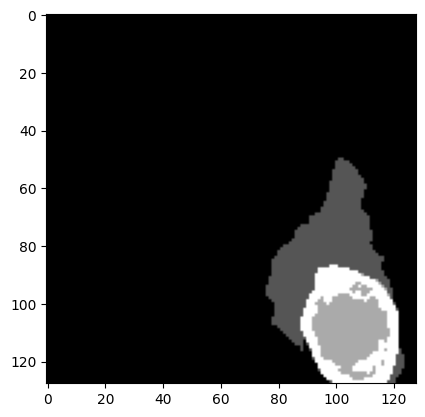

In [53]:
print(y_on.shape)
label_temp = torch.squeeze(y_on, dim=1).squeeze(0)
print(label_temp.shape)
plt.imshow(label_temp[64, :, :], cmap='gray')

plt.show()

START IMAGE: torch.Size([1, 4, 128, 128, 128])
START LABEL: torch.Size([1, 128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.1381) tensor(-2.3969) tensor(0.0199) tensor(0.7935)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(5.4683) tensor(-3.6623) tensor(0.0186) tensor(0.7512)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.2128) tensor(-2.9768) tensor(0.0094) tensor(0.7649)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(5.6358) tensor(-2.2081) tensor(0.0306) tensor(0.7915)
torch.Size([128, 128, 128])


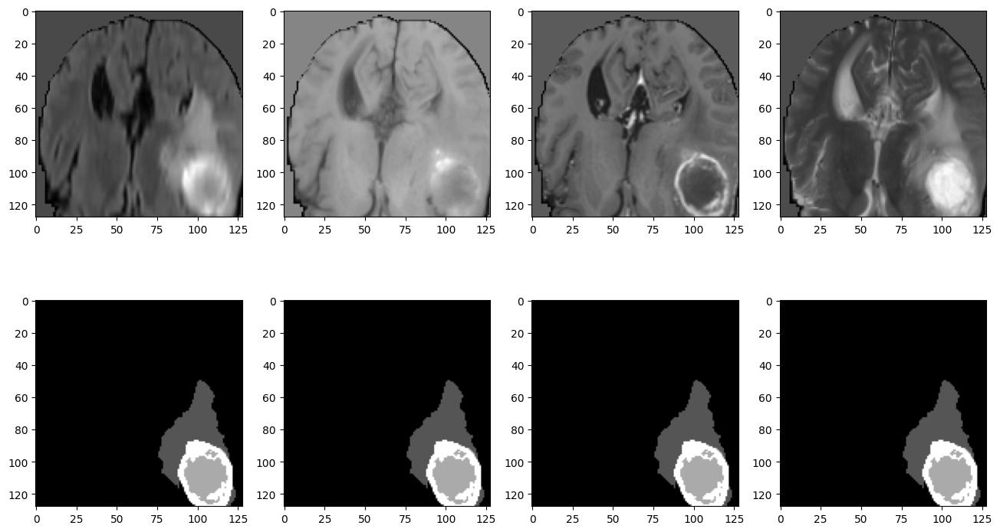

tensor(0.0164, grad_fn=<NllLoss2DBackward0>)
Epoch i:
Shape: torch.Size([128, 128, 128]), Max: 6.150925159454346, Min:-2.474985361099243, Mean:0.011360736563801765, Std:0.7997959852218628
Shape: torch.Size([128, 128, 128]), Max: 5.390162467956543, Min:-3.740387201309204, Mean:0.02299586683511734, Std:0.7596445083618164
Shape: torch.Size([128, 128, 128]), Max: 6.13472318649292, Min:-3.0549380779266357, Mean:0.011368053033947945, Std:0.7735635638237
Shape: torch.Size([128, 128, 128]), Max: 5.577611923217773, Min:-2.2862606048583984, Mean:0.044498663395643234, Std:0.7920114398002625


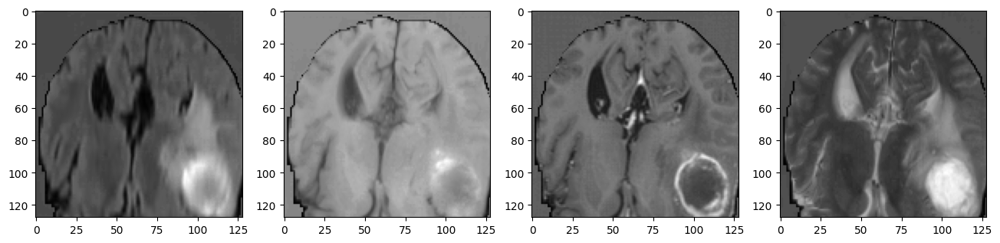

tensor(0.0305, grad_fn=<NllLoss2DBackward0>)
tensor(0.0575, grad_fn=<NllLoss2DBackward0>)
tensor(0.1024, grad_fn=<NllLoss2DBackward0>)
tensor(0.1717, grad_fn=<NllLoss2DBackward0>)
tensor(0.2623, grad_fn=<NllLoss2DBackward0>)
Epoch i:
Shape: torch.Size([128, 128, 128]), Max: 6.541550159454346, Min:-2.865610361099243, Mean:0.023917019367218018, Std:0.8970621228218079
Shape: torch.Size([128, 128, 128]), Max: 5.780787467956543, Min:-4.131011962890625, Mean:0.02267809957265854, Std:0.7586836814880371
Shape: torch.Size([128, 128, 128]), Max: 6.447649955749512, Min:-3.4455630779266357, Mean:0.007151992060244083, Std:0.7500470280647278
Shape: torch.Size([128, 128, 128]), Max: 5.968236923217773, Min:-2.6768856048583984, Mean:0.04403761774301529, Std:0.8483601212501526


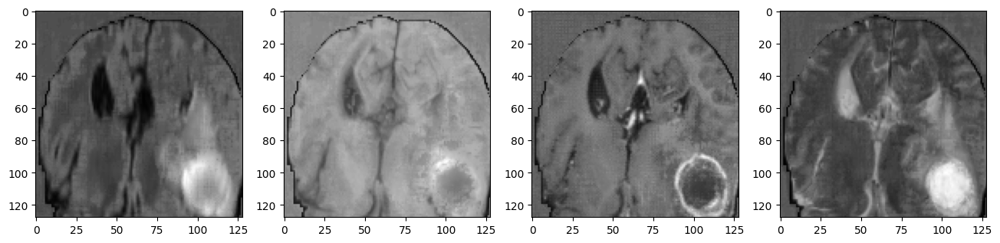

tensor(0.3494, grad_fn=<NllLoss2DBackward0>)
tensor(0.4336, grad_fn=<NllLoss2DBackward0>)
tensor(0.5001, grad_fn=<NllLoss2DBackward0>)
tensor(0.5642, grad_fn=<NllLoss2DBackward0>)


In [54]:
x_adv = pgd_attack(network, workon, y_on)

In [44]:
pred = network(workon).squeeze()
pred_adv = network(x_adv).squeeze()

In [45]:
pred_adv.shape

torch.Size([4, 128, 128, 128])

In [46]:
segmentation = pred.argmax(0)
segmentation_adv = pred_adv.argmax(0)

In [47]:
segmentation.shape

torch.Size([128, 128, 128])

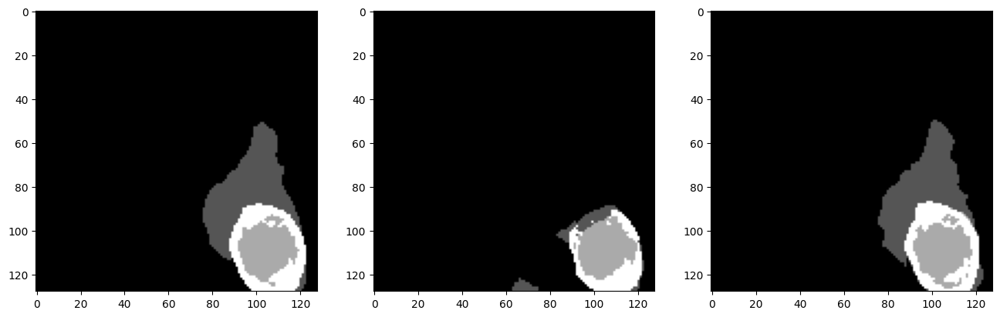

In [48]:
fig, ax = plt.subplots(1, 3, figsize=(16,9))

ax[0].imshow(segmentation[64, :, :], cmap='gray')
ax[1].imshow(segmentation_adv[64, :, :], cmap='gray')
ax[2].imshow(y_on.squeeze()[64, :, :], cmap='gray')

In [50]:
# import SimpleITK as sitk

# sitk.WriteImage()

In [51]:
y_on.min(), y_on.max()

(tensor(0), tensor(3))

Hello, (4, 155, 240, 240)
2 Hello, (4, 155, 240, 240)
(4, 132, 176, 136) (1, 132, 176, 136)
Before normalization: (4, 132, 176, 136)
current shape (132, 176, 136) current_spacing [1.0, 1.0, 1.0] 
target shape [132 176 136] target_spacing [1.0, 1.0, 1.0]
old shape: (132, 176, 136), new_shape: [132 176 136], old_spacing: [1.0, 1.0, 1.0], new_spacing: [1.0, 1.0, 1.0], fn_data: functools.partial(<function resample_data_or_seg_to_shape at 0x000001E1D0A936A0>, is_seg=False, order=3, order_z=0, force_separate_z=None)
(4, 132, 176, 136) (1, 132, 176, 136)
torch.Size([4, 132, 176, 136])
Input image shape: torch.Size([4, 132, 176, 136])
Input label shape: torch.Size([1, 132, 176, 136])
step_size: 0.5
n_steps 8, image size is torch.Size([132, 176, 136]), tile_size [128, 128, 128], tile_step_size 0.5
steps:
[[0, 4], [0, 48], [0, 8]]
move image to device cpu
preallocating results arrays on device cpu


  0%|          | 0/8 [00:00<?, ?it/s]

torch.Size([1, 4, 128, 128, 128]) torch.Size([1, 1, 128, 128, 128])
START IMAGE: torch.Size([1, 4, 128, 128, 128])
START LABEL: torch.Size([1, 128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.1381) tensor(-2.3969) tensor(0.0199) tensor(0.7935)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(5.4683) tensor(-3.6623) tensor(0.0186) tensor(0.7512)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.2128) tensor(-2.9768) tensor(0.0094) tensor(0.7649)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(5.6358) tensor(-2.2081) tensor(0.0306) tensor(0.7915)
torch.Size([128, 128, 128])


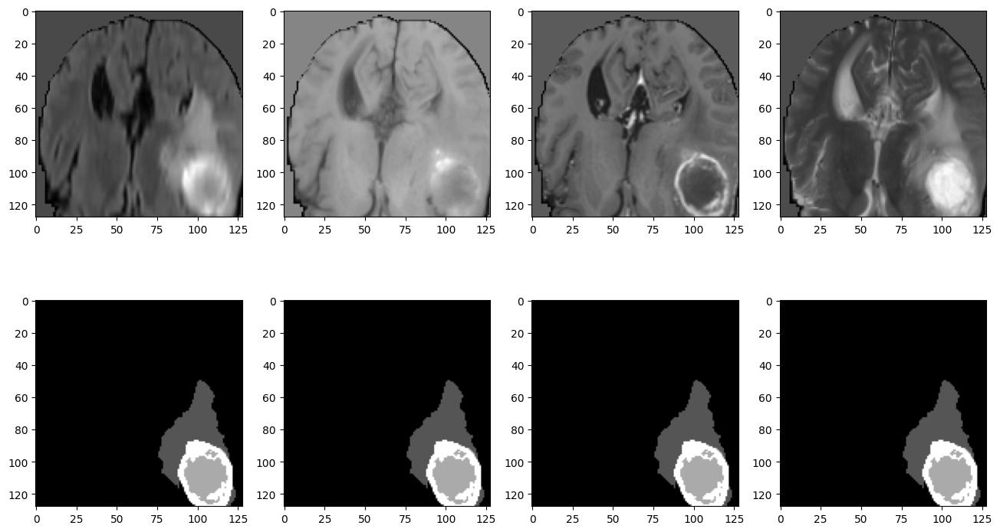

tensor(0.0164, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.150925159454346, Min:-2.474985361099243, Mean:0.011356865987181664, Std:0.7997992038726807
Shape: torch.Size([128, 128, 128]), Max: 5.390162467956543, Min:-3.740387201309204, Mean:0.022996608167886734, Std:0.7596456408500671
Shape: torch.Size([128, 128, 128]), Max: 6.13472318649292, Min:-3.0549380779266357, Mean:0.01136842556297779, Std:0.7735630869865417
Shape: torch.Size([128, 128, 128]), Max: 5.577611923217773, Min:-2.2862606048583984, Mean:0.04449813440442085, Std:0.792014479637146


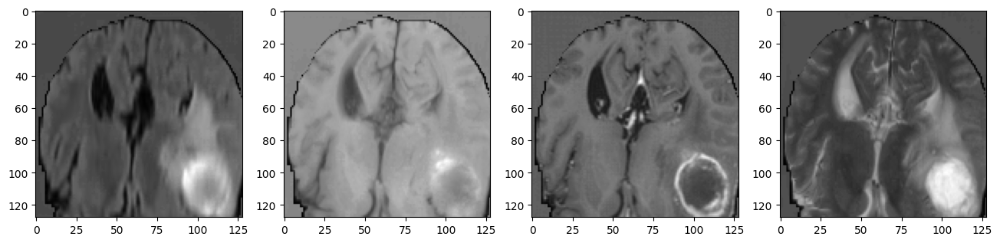

tensor(0.0305, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.229050159454346, Min:-2.553110361099243, Mean:0.017570430412888527, Std:0.8142439723014832
Shape: torch.Size([128, 128, 128]), Max: 5.468287467956543, Min:-3.818512201309204, Mean:0.0220511332154274, Std:0.7584701776504517
Shape: torch.Size([128, 128, 128]), Max: 6.184401988983154, Min:-3.1330630779266357, Mean:0.011808754876255989, Std:0.7707370519638062
Shape: torch.Size([128, 128, 128]), Max: 5.655736923217773, Min:-2.3643856048583984, Mean:0.04325798526406288, Std:0.8036170601844788


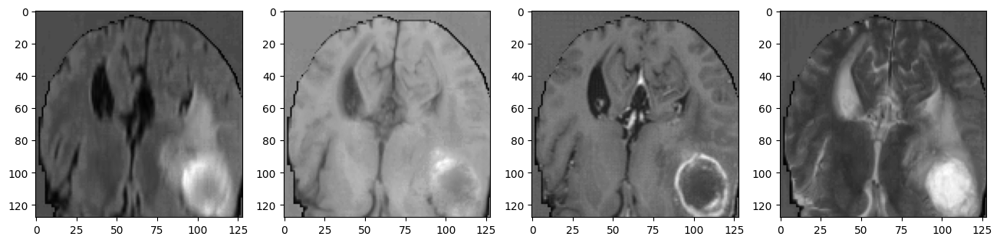

tensor(0.0575, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.307175159454346, Min:-2.631235361099243, Mean:0.023307375609874725, Std:0.8354463577270508
Shape: torch.Size([128, 128, 128]), Max: 5.546412467956543, Min:-3.896637201309204, Mean:0.018975164741277695, Std:0.7576746940612793
Shape: torch.Size([128, 128, 128]), Max: 6.262526988983154, Min:-3.2111880779266357, Mean:0.011839007958769798, Std:0.7653679251670837
Shape: torch.Size([128, 128, 128]), Max: 5.733861923217773, Min:-2.4425106048583984, Mean:0.041621167212724686, Std:0.8163411021232605


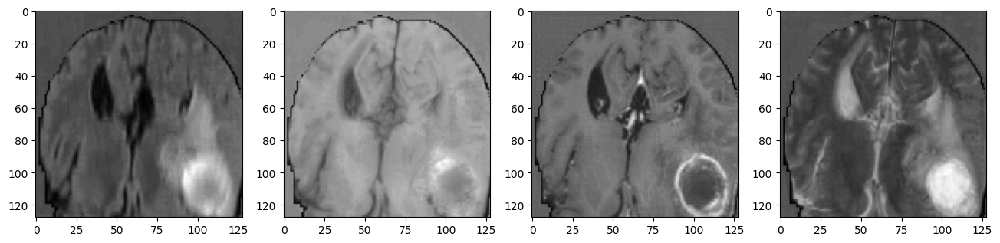

tensor(0.1025, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.385300159454346, Min:-2.709360361099243, Mean:0.02219395898282528, Std:0.8571060299873352
Shape: torch.Size([128, 128, 128]), Max: 5.624537467956543, Min:-3.974762201309204, Mean:0.016628675162792206, Std:0.7577125430107117
Shape: torch.Size([128, 128, 128]), Max: 6.340651988983154, Min:-3.2893130779266357, Mean:0.011423708871006966, Std:0.7607182860374451
Shape: torch.Size([128, 128, 128]), Max: 5.811986923217773, Min:-2.5206356048583984, Mean:0.044263143092393875, Std:0.8263901472091675


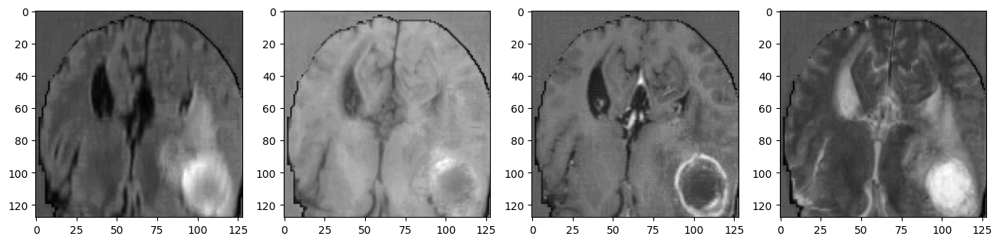

tensor(0.1718, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.463425159454346, Min:-2.787485361099243, Mean:0.024075452238321304, Std:0.8778900504112244
Shape: torch.Size([128, 128, 128]), Max: 5.702662467956543, Min:-4.052886962890625, Mean:0.015342479571700096, Std:0.7559646368026733
Shape: torch.Size([128, 128, 128]), Max: 6.369524955749512, Min:-3.3674380779266357, Mean:0.008660810068249702, Std:0.7555400729179382
Shape: torch.Size([128, 128, 128]), Max: 5.890111923217773, Min:-2.5987606048583984, Mean:0.04130958393216133, Std:0.8397799730300903


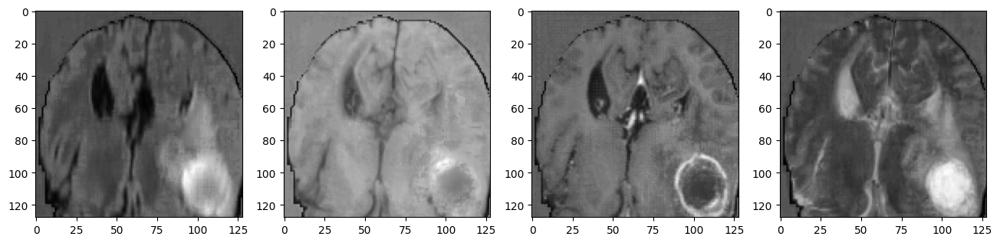

tensor(0.2623, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.541550159454346, Min:-2.865610361099243, Mean:0.02377191372215748, Std:0.8972026705741882
Shape: torch.Size([128, 128, 128]), Max: 5.780787467956543, Min:-4.131011962890625, Mean:0.022759463638067245, Std:0.7590144276618958
Shape: torch.Size([128, 128, 128]), Max: 6.447649955749512, Min:-3.4455630779266357, Mean:0.006997392978519201, Std:0.7493647933006287
Shape: torch.Size([128, 128, 128]), Max: 5.968236923217773, Min:-2.6768856048583984, Mean:0.043826762586832047, Std:0.848109781742096


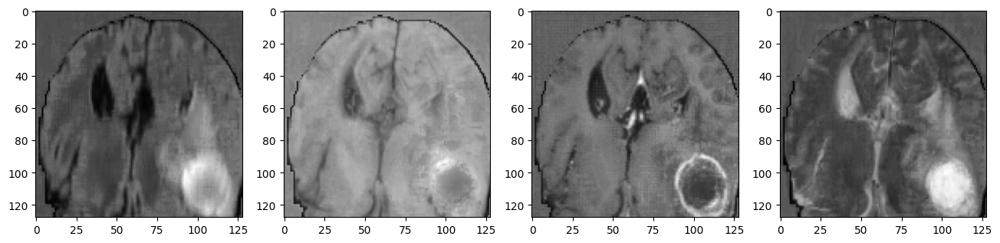

tensor(0.3494, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.619675159454346, Min:-2.943735361099243, Mean:0.023912698030471802, Std:0.9142867922782898
Shape: torch.Size([128, 128, 128]), Max: 5.702662467956543, Min:-4.209136962890625, Mean:0.02072358876466751, Std:0.7627152800559998
Shape: torch.Size([128, 128, 128]), Max: 6.525774955749512, Min:-3.5236880779266357, Mean:0.007229180540889502, Std:0.7519345283508301
Shape: torch.Size([128, 128, 128]), Max: 6.046361923217773, Min:-2.7550106048583984, Mean:0.038976289331912994, Std:0.8623427748680115


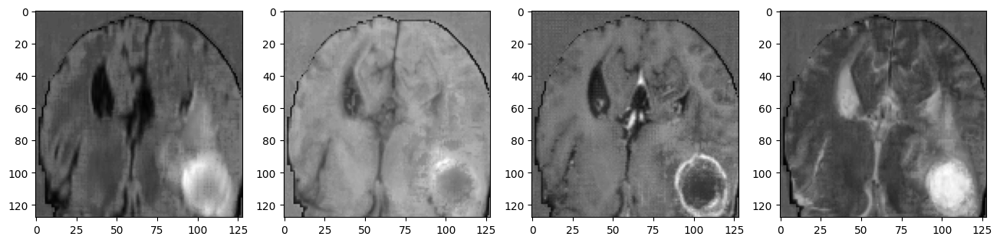

tensor(0.4334, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.697800159454346, Min:-3.021860361099243, Mean:0.02747228555381298, Std:0.9315186738967896
Shape: torch.Size([128, 128, 128]), Max: 5.780787467956543, Min:-4.287261962890625, Mean:0.028581198304891586, Std:0.7688732147216797
Shape: torch.Size([128, 128, 128]), Max: 6.447649955749512, Min:-3.6018130779266357, Mean:0.00763136288151145, Std:0.7497106790542603
Shape: torch.Size([128, 128, 128]), Max: 6.124486923217773, Min:-2.8331356048583984, Mean:0.04440322145819664, Std:0.8729962110519409


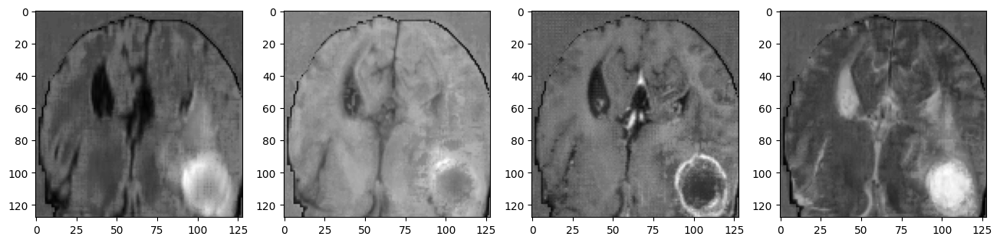

tensor(0.5001, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.775925159454346, Min:-3.099985361099243, Mean:0.029285835102200508, Std:0.9434276223182678
Shape: torch.Size([128, 128, 128]), Max: 5.702662467956543, Min:-4.365386962890625, Mean:0.025967832654714584, Std:0.7767873406410217
Shape: torch.Size([128, 128, 128]), Max: 6.525774955749512, Min:-3.6799380779266357, Mean:0.009538711979985237, Std:0.7553633451461792
Shape: torch.Size([128, 128, 128]), Max: 6.202611923217773, Min:-2.9112606048583984, Mean:0.03890625387430191, Std:0.885802149772644


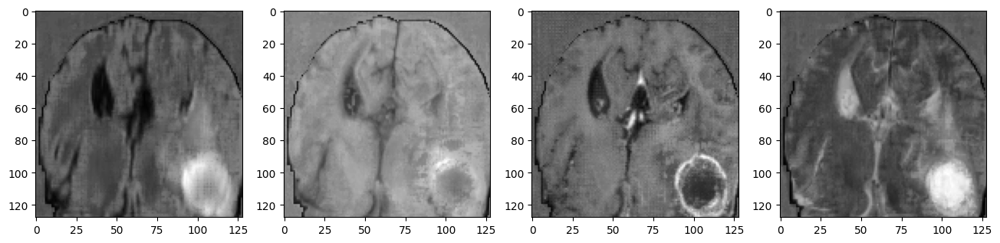

tensor(0.5630, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.854050159454346, Min:-3.178110361099243, Mean:0.02921937219798565, Std:0.9598281383514404
Shape: torch.Size([128, 128, 128]), Max: 5.780787467956543, Min:-4.443511962890625, Mean:0.028675146400928497, Std:0.7848259210586548
Shape: torch.Size([128, 128, 128]), Max: 6.447649955749512, Min:-3.7580630779266357, Mean:0.008238958194851875, Std:0.7514010667800903
Shape: torch.Size([128, 128, 128]), Max: 6.280736923217773, Min:-2.9893856048583984, Mean:0.04095456376671791, Std:0.8938716650009155


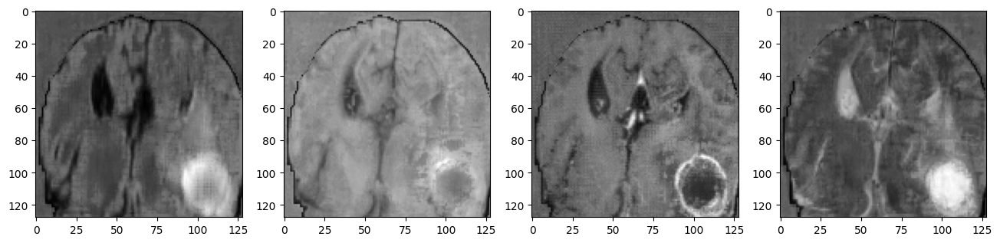

 12%|█▎        | 1/8 [01:25<09:55, 85.01s/it]

torch.Size([1, 4, 128, 128, 128]) torch.Size([1, 1, 128, 128, 128])
START IMAGE: torch.Size([1, 4, 128, 128, 128])
START LABEL: torch.Size([1, 128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.1381) tensor(-2.3969) tensor(0.0211) tensor(0.7927)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(5.4683) tensor(-3.6623) tensor(0.0213) tensor(0.7474)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.2128) tensor(-2.9768) tensor(0.0098) tensor(0.7661)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(5.6358) tensor(-2.2081) tensor(0.0299) tensor(0.7913)
torch.Size([128, 128, 128])


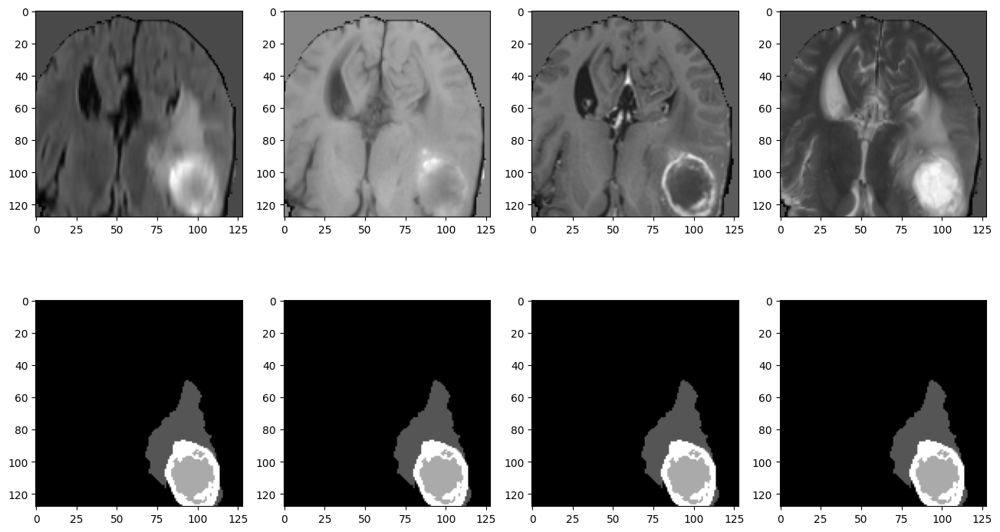

tensor(0.0163, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.150925159454346, Min:-2.474985361099243, Mean:0.010510608553886414, Std:0.7898905277252197
Shape: torch.Size([128, 128, 128]), Max: 5.390162467956543, Min:-3.740387201309204, Mean:0.028183404356241226, Std:0.7623240351676941
Shape: torch.Size([128, 128, 128]), Max: 6.13472318649292, Min:-3.0549380779266357, Mean:0.010381821542978287, Std:0.7731471061706543
Shape: torch.Size([128, 128, 128]), Max: 5.577611923217773, Min:-2.2862606048583984, Mean:0.033375438302755356, Std:0.7890353202819824


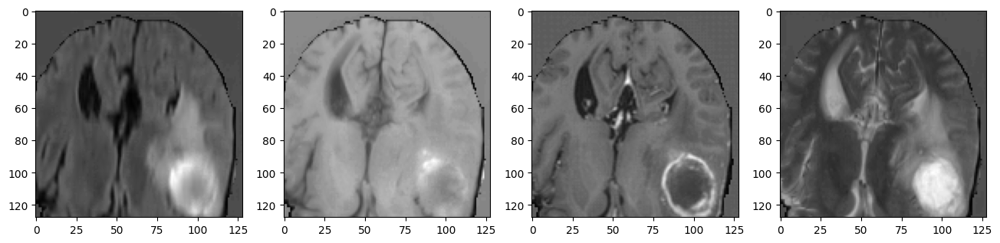

tensor(0.0317, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.229050159454346, Min:-2.553110361099243, Mean:-0.004805915057659149, Std:0.7786200046539307
Shape: torch.Size([128, 128, 128]), Max: 5.468287467956543, Min:-3.818512201309204, Mean:0.026415681466460228, Std:0.7762631177902222
Shape: torch.Size([128, 128, 128]), Max: 6.05659818649292, Min:-3.1330630779266357, Mean:0.01256081834435463, Std:0.7709850668907166
Shape: torch.Size([128, 128, 128]), Max: 5.571141242980957, Min:-2.3643856048583984, Mean:0.013997595757246017, Std:0.7901436686515808


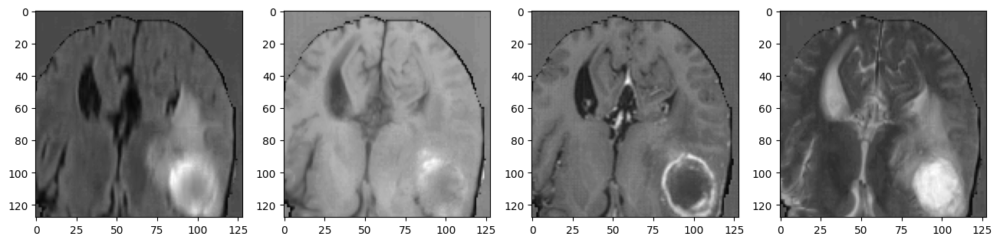

tensor(0.0680, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.150925159454346, Min:-2.631235361099243, Mean:-0.019968219101428986, Std:0.7664546370506287
Shape: torch.Size([128, 128, 128]), Max: 5.546412467956543, Min:-3.896637201309204, Mean:0.028547508642077446, Std:0.7903333306312561
Shape: torch.Size([128, 128, 128]), Max: 5.97847318649292, Min:-3.2111880779266357, Mean:0.012936476618051529, Std:0.771888256072998
Shape: torch.Size([128, 128, 128]), Max: 5.493016242980957, Min:-2.4425106048583984, Mean:0.002594776451587677, Std:0.7889588475227356


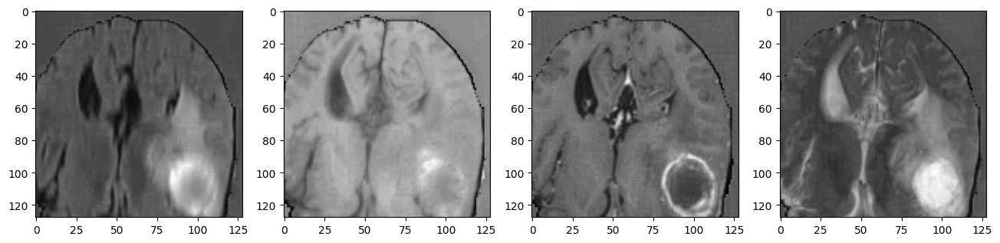

tensor(0.1533, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.229050159454346, Min:-2.709360361099243, Mean:-0.028912417590618134, Std:0.7537282705307007
Shape: torch.Size([128, 128, 128]), Max: 5.624537467956543, Min:-3.974762201309204, Mean:0.021116681396961212, Std:0.80190509557724
Shape: torch.Size([128, 128, 128]), Max: 5.90034818649292, Min:-3.2893130779266357, Mean:0.011399347335100174, Std:0.7732252478599548
Shape: torch.Size([128, 128, 128]), Max: 5.414891242980957, Min:-2.5206356048583984, Mean:-0.01035992056131363, Std:0.7909020185470581


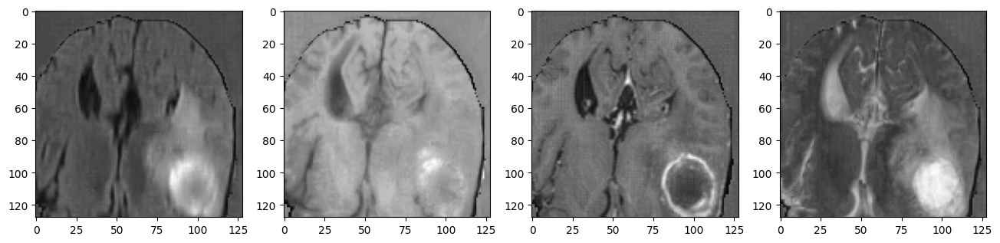

tensor(0.2682, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.2511773109436035, Min:-2.787485361099243, Mean:-0.04347747936844826, Std:0.7426367998123169
Shape: torch.Size([128, 128, 128]), Max: 5.702662467956543, Min:-4.052886962890625, Mean:0.019875265657901764, Std:0.8139508366584778
Shape: torch.Size([128, 128, 128]), Max: 5.82222318649292, Min:-3.3674380779266357, Mean:0.012043971568346024, Std:0.7748991847038269
Shape: torch.Size([128, 128, 128]), Max: 5.336766242980957, Min:-2.5987606048583984, Mean:-0.02309705689549446, Std:0.7902430295944214


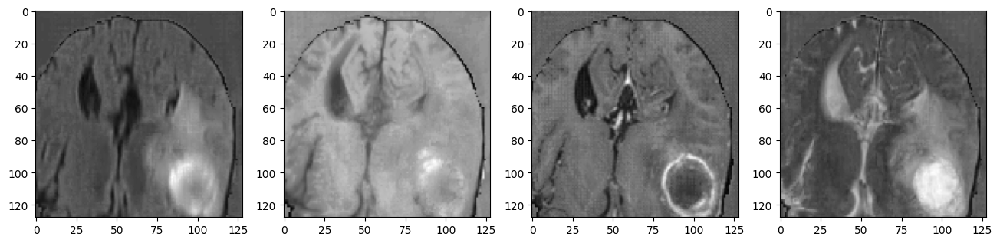

tensor(0.3990, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.3293023109436035, Min:-2.865610361099243, Mean:-0.056974876672029495, Std:0.7365766763687134
Shape: torch.Size([128, 128, 128]), Max: 5.780787467956543, Min:-4.131011962890625, Mean:0.015316029079258442, Std:0.8234066963195801
Shape: torch.Size([128, 128, 128]), Max: 5.74409818649292, Min:-3.4455630779266357, Mean:0.013002563267946243, Std:0.7739282846450806
Shape: torch.Size([128, 128, 128]), Max: 5.373750686645508, Min:-2.6768856048583984, Mean:-0.03955405578017235, Std:0.7939801812171936


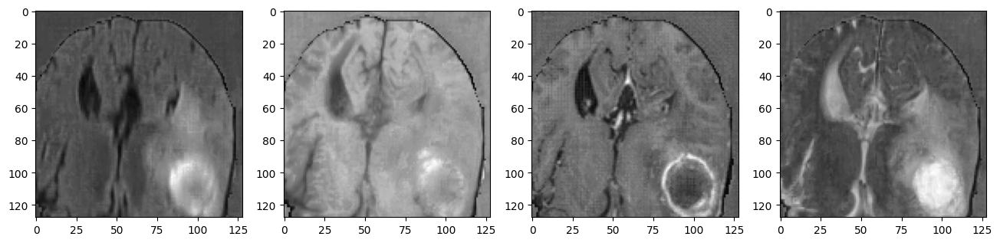

tensor(0.5385, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.4074273109436035, Min:-2.943735361099243, Mean:-0.07742232829332352, Std:0.7356343865394592
Shape: torch.Size([128, 128, 128]), Max: 5.702662467956543, Min:-4.209136962890625, Mean:0.020275361835956573, Std:0.8301934599876404
Shape: torch.Size([128, 128, 128]), Max: 5.66597318649292, Min:-3.5236880779266357, Mean:0.012586038559675217, Std:0.7694882154464722
Shape: torch.Size([128, 128, 128]), Max: 5.451875686645508, Min:-2.7550106048583984, Mean:-0.053372111171483994, Std:0.7945048809051514


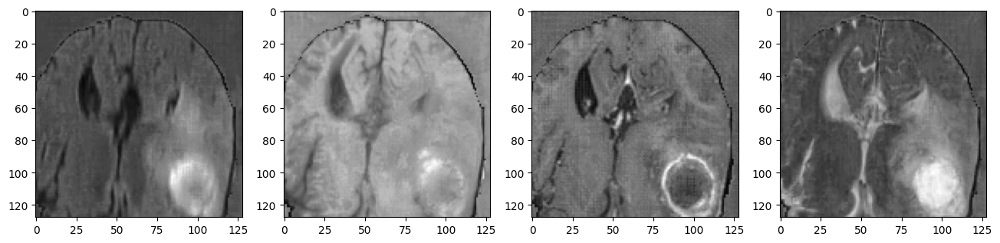

tensor(0.6550, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.4855523109436035, Min:-3.021860361099243, Mean:-0.09301884472370148, Std:0.7387089729309082
Shape: torch.Size([128, 128, 128]), Max: 5.65435791015625, Min:-4.287261962890625, Mean:0.02925398200750351, Std:0.8369438648223877
Shape: torch.Size([128, 128, 128]), Max: 5.58784818649292, Min:-3.6018130779266357, Mean:0.008835416287183762, Std:0.7643497586250305
Shape: torch.Size([128, 128, 128]), Max: 5.530000686645508, Min:-2.8331356048583984, Mean:-0.07172147929668427, Std:0.7961370944976807


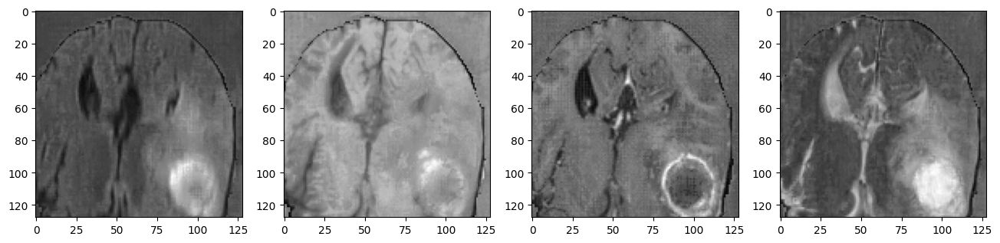

tensor(0.7727, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.4074273109436035, Min:-3.099985361099243, Mean:-0.10597667098045349, Std:0.7451900839805603
Shape: torch.Size([128, 128, 128]), Max: 5.73248291015625, Min:-4.365386962890625, Mean:0.03851669281721115, Std:0.8412614464759827
Shape: torch.Size([128, 128, 128]), Max: 5.618995666503906, Min:-3.6799380779266357, Mean:0.0023107146844267845, Std:0.7528676390647888
Shape: torch.Size([128, 128, 128]), Max: 5.608125686645508, Min:-2.9112606048583984, Mean:-0.08958425372838974, Std:0.7951318621635437


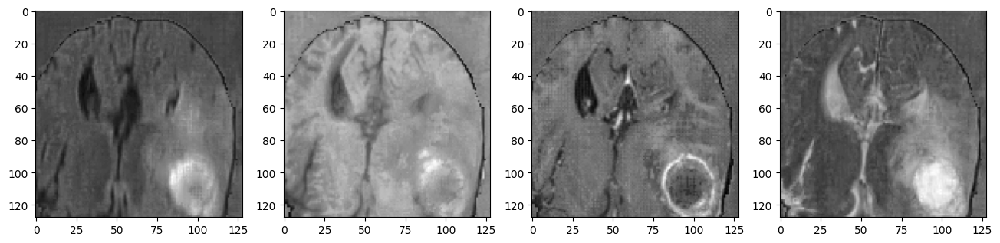

tensor(0.8814, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.4855523109436035, Min:-3.178110361099243, Mean:-0.11344438791275024, Std:0.7481789588928223
Shape: torch.Size([128, 128, 128]), Max: 5.780787467956543, Min:-4.443511962890625, Mean:0.044424183666706085, Std:0.8464397192001343
Shape: torch.Size([128, 128, 128]), Max: 5.697120666503906, Min:-3.7580630779266357, Mean:-0.0026287944056093693, Std:0.7500015497207642
Shape: torch.Size([128, 128, 128]), Max: 5.686250686645508, Min:-2.9893856048583984, Mean:-0.10294395685195923, Std:0.8004765510559082


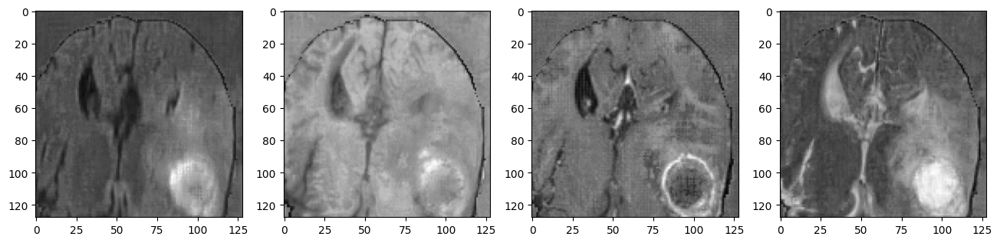

 25%|██▌       | 2/8 [02:52<08:37, 86.25s/it]

torch.Size([1, 4, 128, 128, 128]) torch.Size([1, 1, 128, 128, 128])
START IMAGE: torch.Size([1, 4, 128, 128, 128])
START LABEL: torch.Size([1, 128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.1381) tensor(-2.3969) tensor(0.0224) tensor(0.7726)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.4906) tensor(-3.6623) tensor(0.0014) tensor(0.7268)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.0323) tensor(-2.9768) tensor(0.0092) tensor(0.7331)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(5.6358) tensor(-2.2081) tensor(0.0191) tensor(0.7700)
torch.Size([128, 128, 128])


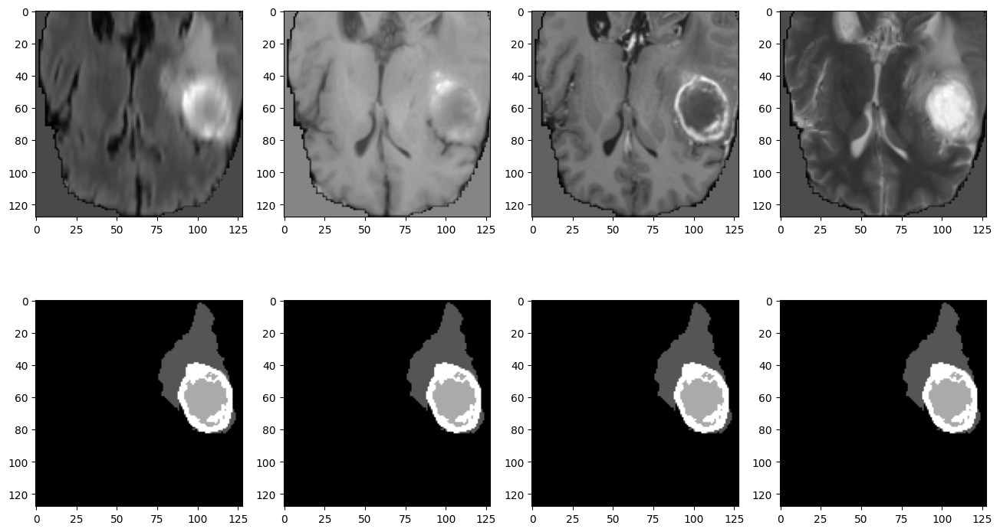

tensor(0.0175, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.150925159454346, Min:-2.474985361099243, Mean:0.011745572090148926, Std:0.772108256816864
Shape: torch.Size([128, 128, 128]), Max: 6.568770408630371, Min:-3.740387201309204, Mean:0.0024569425731897354, Std:0.735755205154419
Shape: torch.Size([128, 128, 128]), Max: 6.110381603240967, Min:-3.0549380779266357, Mean:0.015541929751634598, Std:0.743190348148346
Shape: torch.Size([128, 128, 128]), Max: 5.557655334472656, Min:-2.2862606048583984, Mean:0.026737667620182037, Std:0.7686981558799744


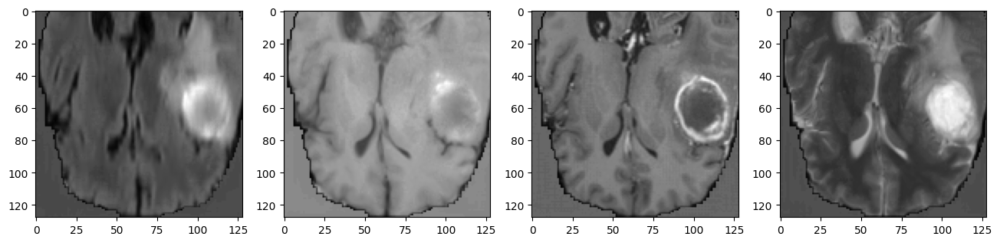

tensor(0.0310, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.126387596130371, Min:-2.553110361099243, Mean:0.0019628857262432575, Std:0.7630536556243896
Shape: torch.Size([128, 128, 128]), Max: 6.646895408630371, Min:-3.818512201309204, Mean:-0.002471761777997017, Std:0.7481026649475098
Shape: torch.Size([128, 128, 128]), Max: 6.032256603240967, Min:-3.1330630779266357, Mean:0.02018185332417488, Std:0.7440656423568726
Shape: torch.Size([128, 128, 128]), Max: 5.479530334472656, Min:-2.3643856048583984, Mean:0.016271091997623444, Std:0.7684813141822815


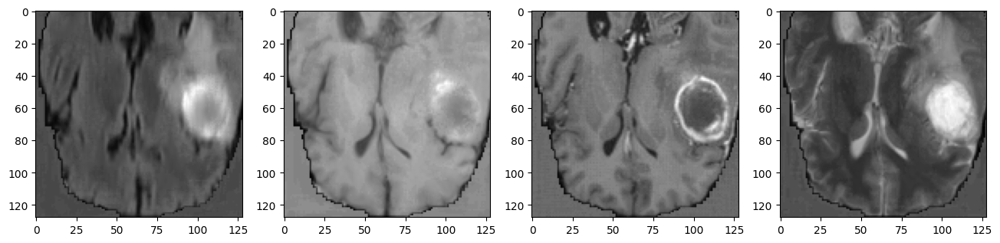

tensor(0.0578, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.143848419189453, Min:-2.631235361099243, Mean:-0.008682354353368282, Std:0.7496445775032043
Shape: torch.Size([128, 128, 128]), Max: 6.725020408630371, Min:-3.896637201309204, Mean:-0.0036102868616580963, Std:0.7588571906089783
Shape: torch.Size([128, 128, 128]), Max: 5.954131603240967, Min:-3.2111880779266357, Mean:0.02137223444879055, Std:0.747840940952301
Shape: torch.Size([128, 128, 128]), Max: 5.401405334472656, Min:-2.4425106048583984, Mean:0.003387320786714554, Std:0.7671059966087341


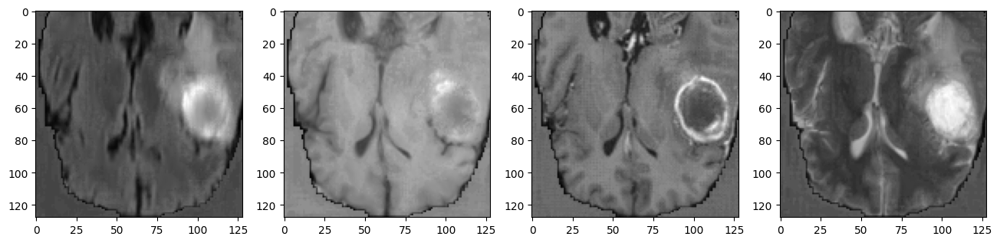

tensor(0.1260, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.072800159454346, Min:-2.709360361099243, Mean:-0.016278818249702454, Std:0.7373864650726318
Shape: torch.Size([128, 128, 128]), Max: 6.803145408630371, Min:-3.974762201309204, Mean:-0.006349494680762291, Std:0.7697587013244629
Shape: torch.Size([128, 128, 128]), Max: 5.876006603240967, Min:-3.2893130779266357, Mean:0.02018415927886963, Std:0.752236545085907
Shape: torch.Size([128, 128, 128]), Max: 5.379608154296875, Min:-2.5206356048583984, Mean:-0.009636292234063148, Std:0.7677764296531677


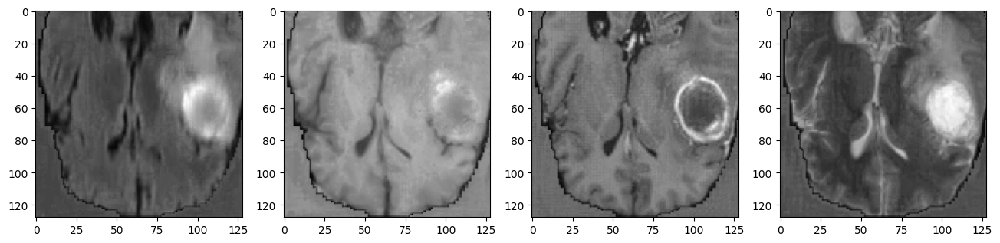

tensor(0.2302, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.071441173553467, Min:-2.787485361099243, Mean:-0.03094535879790783, Std:0.7257619500160217
Shape: torch.Size([128, 128, 128]), Max: 6.881270408630371, Min:-4.052886962890625, Mean:-0.008582359179854393, Std:0.7824649214744568
Shape: torch.Size([128, 128, 128]), Max: 5.797881603240967, Min:-3.3674380779266357, Mean:0.019577911123633385, Std:0.7559813261032104
Shape: torch.Size([128, 128, 128]), Max: 5.401405334472656, Min:-2.5987606048583984, Mean:-0.023228460922837257, Std:0.7665396928787231


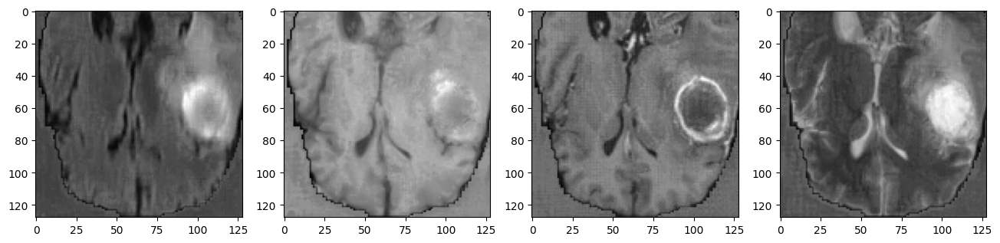

tensor(0.3388, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.149566173553467, Min:-2.865610361099243, Mean:-0.045534342527389526, Std:0.7184250354766846
Shape: torch.Size([128, 128, 128]), Max: 6.959395408630371, Min:-4.131011962890625, Mean:-0.0076923128217458725, Std:0.7943161129951477
Shape: torch.Size([128, 128, 128]), Max: 5.822649955749512, Min:-3.4455630779266357, Mean:0.019477475434541702, Std:0.7590072154998779
Shape: torch.Size([128, 128, 128]), Max: 5.460661888122559, Min:-2.6768856048583984, Mean:-0.0385073684155941, Std:0.7671814560890198


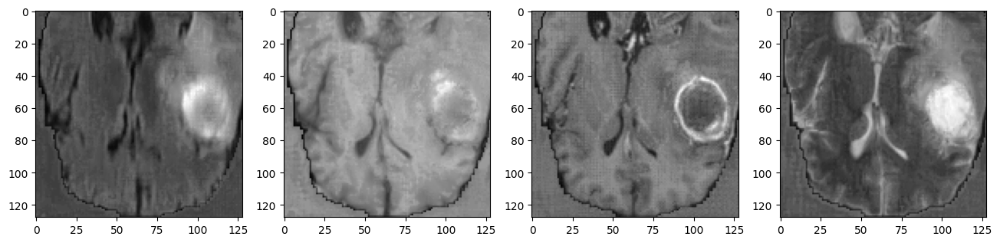

tensor(0.4586, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.227691173553467, Min:-2.943735361099243, Mean:-0.06185230612754822, Std:0.7153890132904053
Shape: torch.Size([128, 128, 128]), Max: 6.881270408630371, Min:-4.209136962890625, Mean:-0.011052301153540611, Std:0.804117739200592
Shape: torch.Size([128, 128, 128]), Max: 5.744524955749512, Min:-3.5236880779266357, Mean:0.019305886700749397, Std:0.7582356333732605
Shape: torch.Size([128, 128, 128]), Max: 5.538786888122559, Min:-2.7550106048583984, Mean:-0.05225927755236626, Std:0.7695600390434265


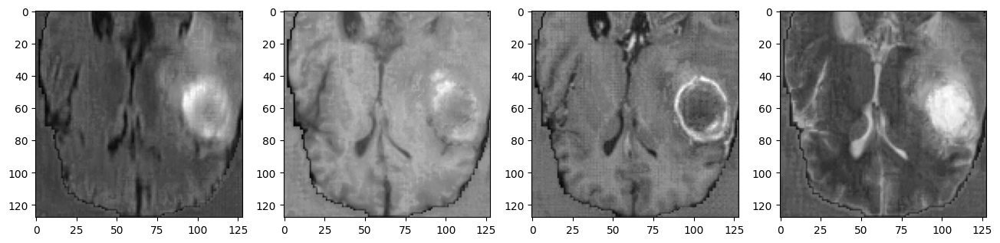

tensor(0.5825, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.229050159454346, Min:-2.989194869995117, Mean:-0.07946553826332092, Std:0.7146585583686829
Shape: torch.Size([128, 128, 128]), Max: 6.803145408630371, Min:-4.287261962890625, Mean:-0.005414895713329315, Std:0.8111903071403503
Shape: torch.Size([128, 128, 128]), Max: 5.666399955749512, Min:-3.6018130779266357, Mean:0.019526425749063492, Std:0.7562936544418335
Shape: torch.Size([128, 128, 128]), Max: 5.530000686645508, Min:-2.8331356048583984, Mean:-0.06592938303947449, Std:0.7702723145484924


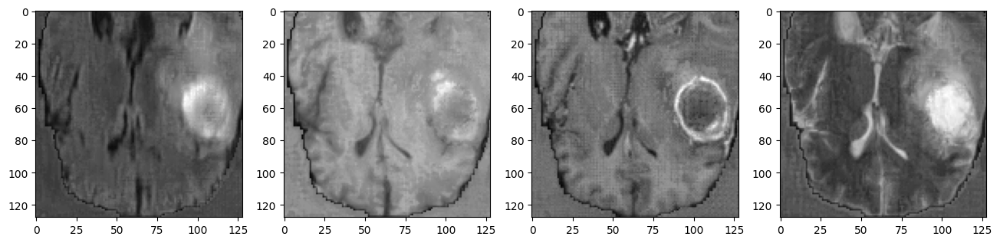

tensor(0.6863, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.160104274749756, Min:-3.0346546173095703, Mean:-0.09100164473056793, Std:0.7155990600585938
Shape: torch.Size([128, 128, 128]), Max: 6.725020408630371, Min:-4.365386962890625, Mean:-0.00449847336858511, Std:0.8202592134475708
Shape: torch.Size([128, 128, 128]), Max: 5.618995666503906, Min:-3.6799380779266357, Mean:0.016945919021964073, Std:0.7531363368034363
Shape: torch.Size([128, 128, 128]), Max: 5.451875686645508, Min:-2.9112606048583984, Mean:-0.07727587223052979, Std:0.7705703377723694


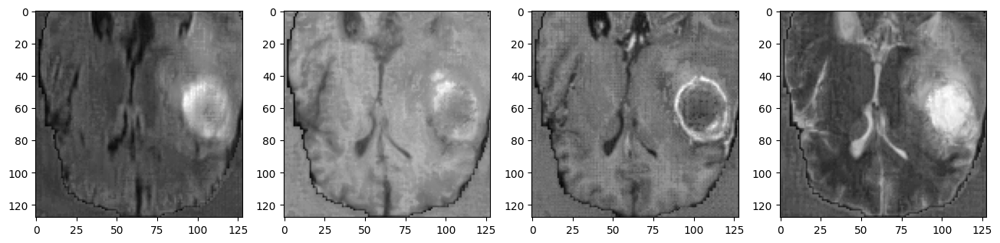

tensor(0.7756, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.238229274749756, Min:-3.0987801551818848, Mean:-0.10101626813411713, Std:0.7187538743019104
Shape: torch.Size([128, 128, 128]), Max: 6.646895408630371, Min:-4.443511962890625, Mean:0.0022647157311439514, Std:0.8257530331611633
Shape: torch.Size([128, 128, 128]), Max: 5.684238910675049, Min:-3.7580630779266357, Mean:0.011518096551299095, Std:0.7474644780158997
Shape: torch.Size([128, 128, 128]), Max: 5.373750686645508, Min:-2.9611868858337402, Mean:-0.0883810967206955, Std:0.7702084183692932


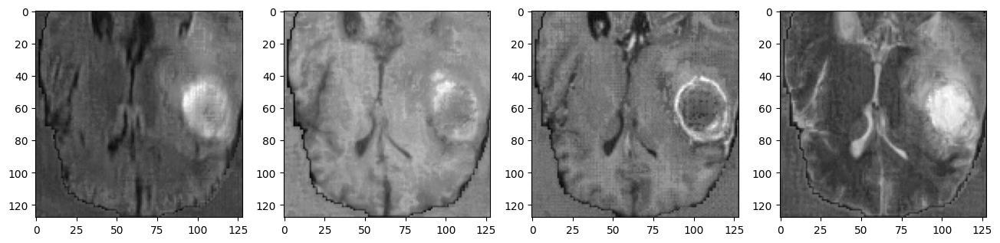

 38%|███▊      | 3/8 [04:17<07:10, 86.06s/it]

torch.Size([1, 4, 128, 128, 128]) torch.Size([1, 1, 128, 128, 128])
START IMAGE: torch.Size([1, 4, 128, 128, 128])
START LABEL: torch.Size([1, 128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.1381) tensor(-2.3969) tensor(0.0235) tensor(0.7717)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.4906) tensor(-3.6623) tensor(0.0040) tensor(0.7229)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.0323) tensor(-2.9768) tensor(0.0095) tensor(0.7344)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(5.6358) tensor(-2.2081) tensor(0.0184) tensor(0.7698)
torch.Size([128, 128, 128])


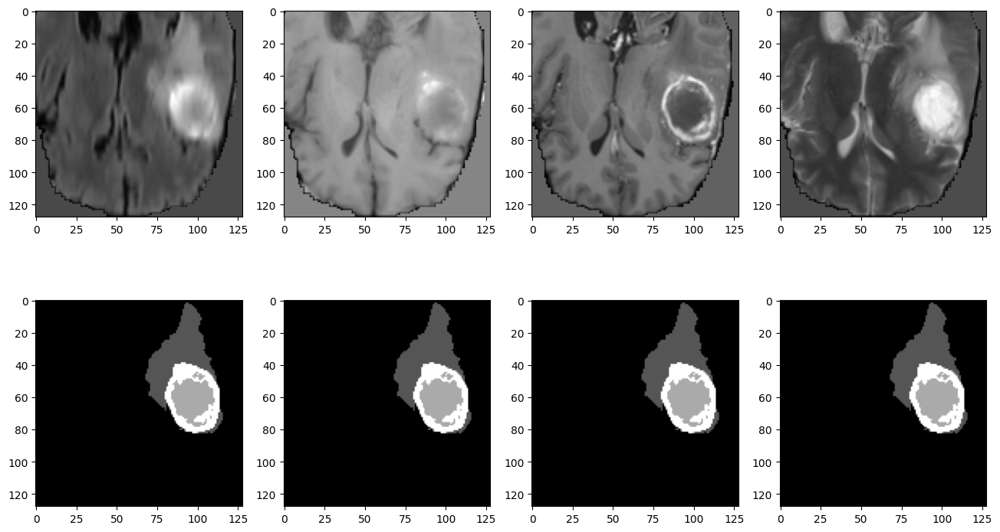

tensor(0.0173, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.0949273109436035, Min:-2.474985361099243, Mean:0.011592444032430649, Std:0.7651746273040771
Shape: torch.Size([128, 128, 128]), Max: 6.568770408630371, Min:-3.740387201309204, Mean:0.006557609885931015, Std:0.7358284592628479
Shape: torch.Size([128, 128, 128]), Max: 6.110381603240967, Min:-3.0549380779266357, Mean:0.014357800595462322, Std:0.7426816821098328
Shape: torch.Size([128, 128, 128]), Max: 5.557655334472656, Min:-2.2862606048583984, Mean:0.01673148199915886, Std:0.7684205770492554


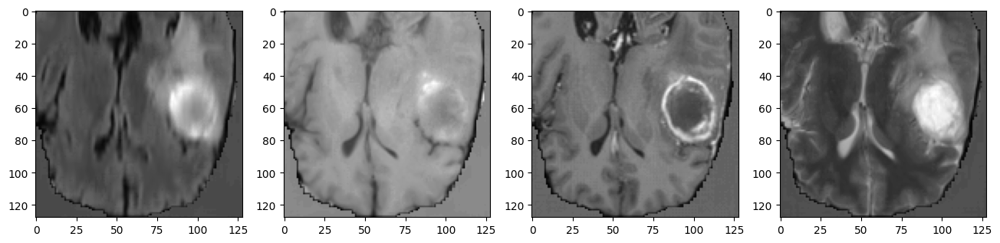

tensor(0.0337, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.126387596130371, Min:-2.553110361099243, Mean:-0.004148771055042744, Std:0.7513849139213562
Shape: torch.Size([128, 128, 128]), Max: 6.646895408630371, Min:-3.818512201309204, Mean:0.005426909774541855, Std:0.752054750919342
Shape: torch.Size([128, 128, 128]), Max: 6.032256603240967, Min:-3.1330630779266357, Mean:0.015365936793386936, Std:0.7435097694396973
Shape: torch.Size([128, 128, 128]), Max: 5.479530334472656, Min:-2.3643856048583984, Mean:-0.001085761934518814, Std:0.7671664357185364


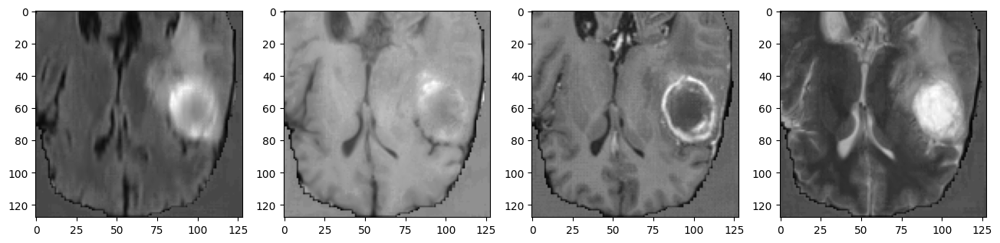

tensor(0.0785, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.048262596130371, Min:-2.631235361099243, Mean:-0.018050510436296463, Std:0.7385674118995667
Shape: torch.Size([128, 128, 128]), Max: 6.725020408630371, Min:-3.896637201309204, Mean:0.00526009127497673, Std:0.7654972076416016
Shape: torch.Size([128, 128, 128]), Max: 5.954131603240967, Min:-3.2111880779266357, Mean:0.013690078631043434, Std:0.7461453676223755
Shape: torch.Size([128, 128, 128]), Max: 5.401405334472656, Min:-2.4425106048583984, Mean:-0.014098649844527245, Std:0.766677737236023


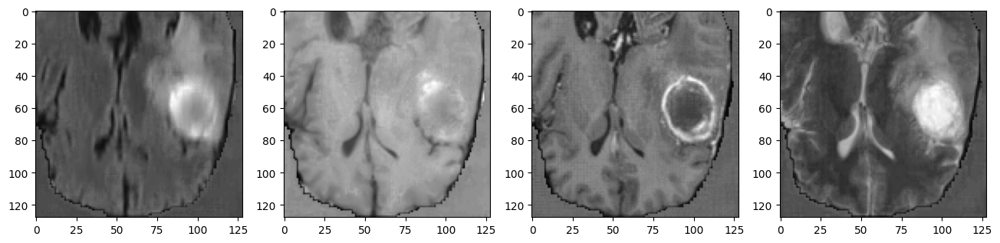

tensor(0.1795, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.0168023109436035, Min:-2.709360361099243, Mean:-0.02980581298470497, Std:0.726806104183197
Shape: torch.Size([128, 128, 128]), Max: 6.803145408630371, Min:-3.974762201309204, Mean:-8.182786405086517e-05, Std:0.7788201570510864
Shape: torch.Size([128, 128, 128]), Max: 5.876006603240967, Min:-3.2893130779266357, Mean:0.011605330742895603, Std:0.7487589120864868
Shape: torch.Size([128, 128, 128]), Max: 5.323280334472656, Min:-2.5206356048583984, Mean:-0.027268964797258377, Std:0.7674750089645386


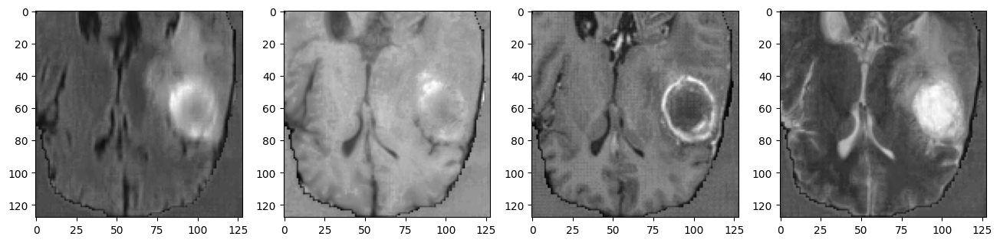

tensor(0.2953, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.071441173553467, Min:-2.787485361099243, Mean:-0.046874724328517914, Std:0.7169588208198547
Shape: torch.Size([128, 128, 128]), Max: 6.881270408630371, Min:-4.052886962890625, Mean:-0.0012123789638280869, Std:0.7928972244262695
Shape: torch.Size([128, 128, 128]), Max: 5.797881603240967, Min:-3.3674380779266357, Mean:0.01241193525493145, Std:0.7511067986488342
Shape: torch.Size([128, 128, 128]), Max: 5.382536888122559, Min:-2.5987606048583984, Mean:-0.042251262813806534, Std:0.7670240998268127


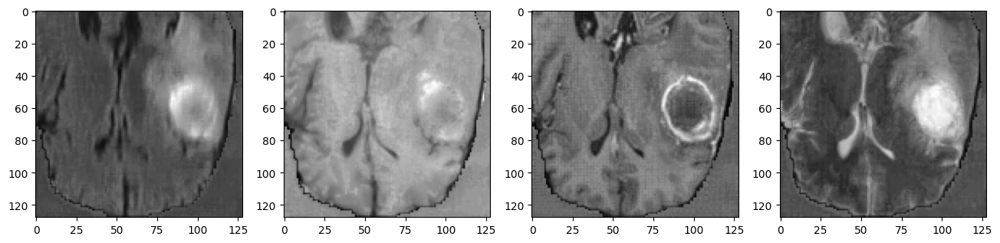

tensor(0.4252, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.149566173553467, Min:-2.865610361099243, Mean:-0.06490595638751984, Std:0.7126342058181763
Shape: torch.Size([128, 128, 128]), Max: 6.803145408630371, Min:-4.131011962890625, Mean:-0.0026092883199453354, Std:0.8039218187332153
Shape: torch.Size([128, 128, 128]), Max: 5.719756603240967, Min:-3.4455630779266357, Mean:0.014471719041466713, Std:0.7502861022949219
Shape: torch.Size([128, 128, 128]), Max: 5.460661888122559, Min:-2.6768856048583984, Mean:-0.05932970717549324, Std:0.7703302502632141


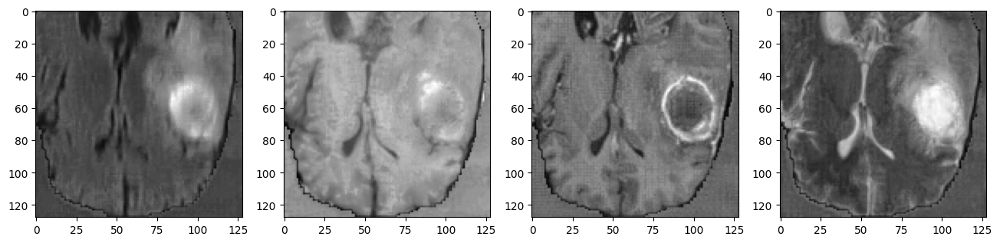

tensor(0.5557, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.227691173553467, Min:-2.943735361099243, Mean:-0.07279552519321442, Std:0.7092426419258118
Shape: torch.Size([128, 128, 128]), Max: 6.725020408630371, Min:-4.209136962890625, Mean:-0.006305818445980549, Std:0.8128581643104553
Shape: torch.Size([128, 128, 128]), Max: 5.744524955749512, Min:-3.5236880779266357, Mean:0.01326792873442173, Std:0.7473049759864807
Shape: torch.Size([128, 128, 128]), Max: 5.451875686645508, Min:-2.7550106048583984, Mean:-0.06905956566333771, Std:0.7704493999481201


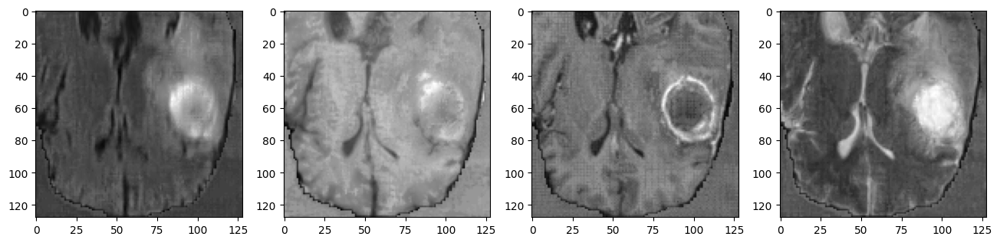

tensor(0.6680, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.305816173553467, Min:-3.021860361099243, Mean:-0.0846514105796814, Std:0.7104004621505737
Shape: torch.Size([128, 128, 128]), Max: 6.646895408630371, Min:-4.287261962890625, Mean:-0.0042984094470739365, Std:0.8208812475204468
Shape: torch.Size([128, 128, 128]), Max: 5.822649955749512, Min:-3.5977087020874023, Mean:0.008841389790177345, Std:0.7447059154510498
Shape: torch.Size([128, 128, 128]), Max: 5.530000686645508, Min:-2.757939100265503, Mean:-0.07926717400550842, Std:0.7732939720153809


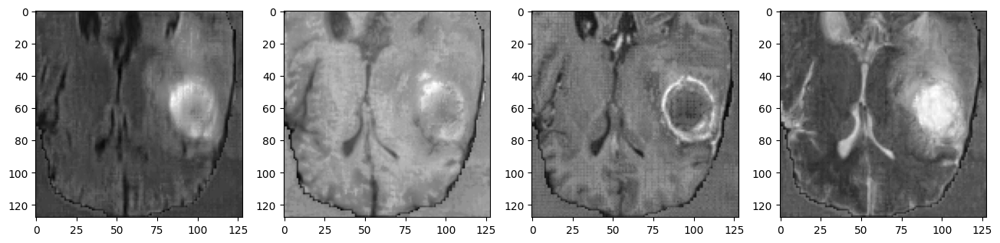

tensor(0.7605, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.383941173553467, Min:-2.943735361099243, Mean:-0.09330302476882935, Std:0.7132333517074585
Shape: torch.Size([128, 128, 128]), Max: 6.568770408630371, Min:-4.365386962890625, Mean:-0.0016255136579275131, Std:0.8264855742454529
Shape: torch.Size([128, 128, 128]), Max: 5.900774955749512, Min:-3.6553118228912354, Mean:0.00492924265563488, Std:0.7389834523200989
Shape: torch.Size([128, 128, 128]), Max: 5.451875686645508, Min:-2.7561681270599365, Mean:-0.09249113500118256, Std:0.7729169726371765


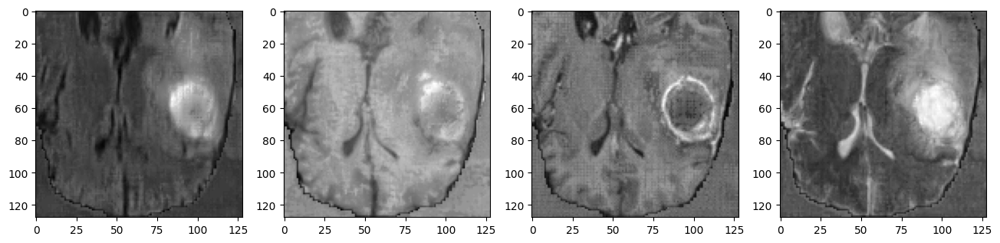

tensor(0.8630, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.462066173553467, Min:-3.021860361099243, Mean:-0.10053396224975586, Std:0.71849125623703
Shape: torch.Size([128, 128, 128]), Max: 6.490645408630371, Min:-4.443511962890625, Mean:-0.0006862189620733261, Std:0.8326297402381897
Shape: torch.Size([128, 128, 128]), Max: 5.822649955749512, Min:-3.7334368228912354, Mean:0.003306427039206028, Std:0.7333380579948425
Shape: torch.Size([128, 128, 128]), Max: 5.424290657043457, Min:-2.8342931270599365, Mean:-0.10170072317123413, Std:0.7718321084976196


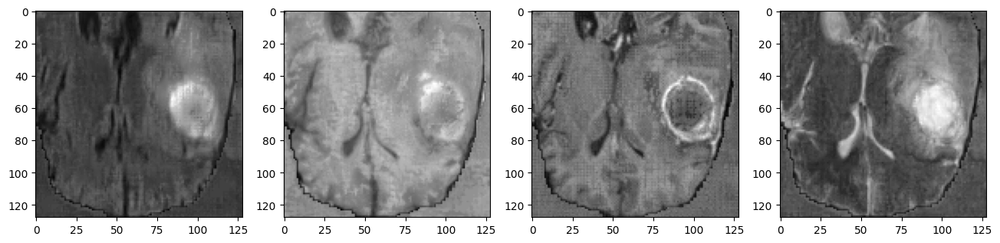

 50%|█████     | 4/8 [05:43<05:44, 86.03s/it]

torch.Size([1, 4, 128, 128, 128]) torch.Size([1, 1, 128, 128, 128])
START IMAGE: torch.Size([1, 4, 128, 128, 128])
START LABEL: torch.Size([1, 128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.1381) tensor(-2.3969) tensor(0.0223) tensor(0.7845)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(5.4683) tensor(-3.6623) tensor(0.0234) tensor(0.7397)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.2128) tensor(-2.9768) tensor(0.0170) tensor(0.7534)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(5.6358) tensor(-2.2081) tensor(0.0319) tensor(0.7877)
torch.Size([128, 128, 128])


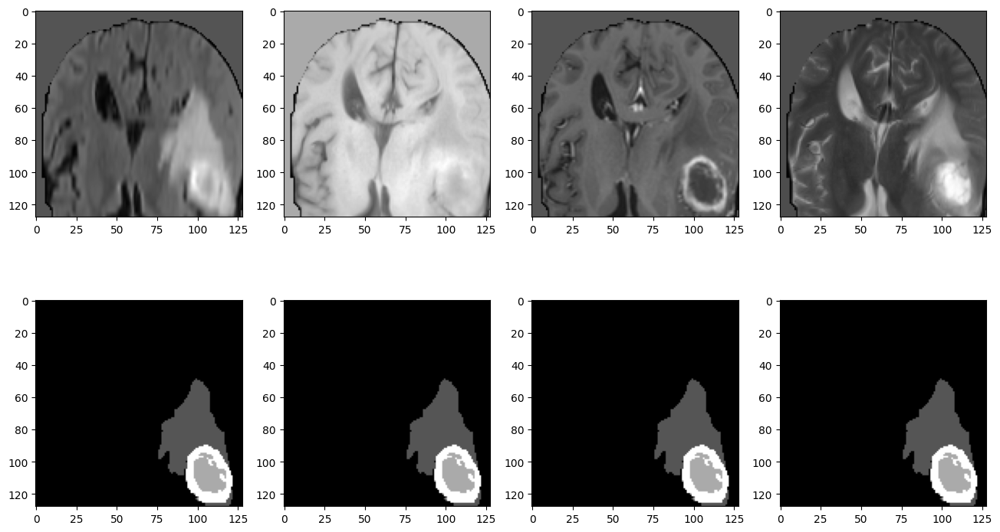

tensor(0.0165, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.150925159454346, Min:-2.474985361099243, Mean:0.01907063089311123, Std:0.7929785251617432
Shape: torch.Size([128, 128, 128]), Max: 5.390162467956543, Min:-3.740387201309204, Mean:0.02658839337527752, Std:0.7460080981254578
Shape: torch.Size([128, 128, 128]), Max: 6.13472318649292, Min:-3.0549380779266357, Mean:0.019080929458141327, Std:0.7583546042442322
Shape: torch.Size([128, 128, 128]), Max: 5.61991024017334, Min:-2.2862606048583984, Mean:0.04330630600452423, Std:0.7880754470825195


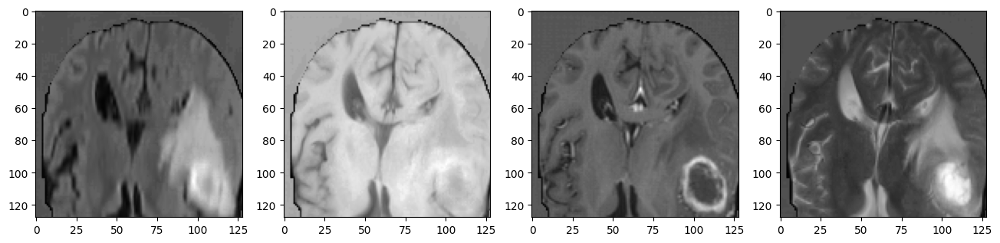

tensor(0.0311, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.229050159454346, Min:-2.553110361099243, Mean:0.02520647644996643, Std:0.8128276467323303
Shape: torch.Size([128, 128, 128]), Max: 5.312037467956543, Min:-3.818512201309204, Mean:0.026391401886940002, Std:0.7434728145599365
Shape: torch.Size([128, 128, 128]), Max: 6.184401988983154, Min:-3.1330630779266357, Mean:0.01732795685529709, Std:0.7549482583999634
Shape: torch.Size([128, 128, 128]), Max: 5.69803524017334, Min:-2.3643856048583984, Mean:0.047821879386901855, Std:0.7974322438240051


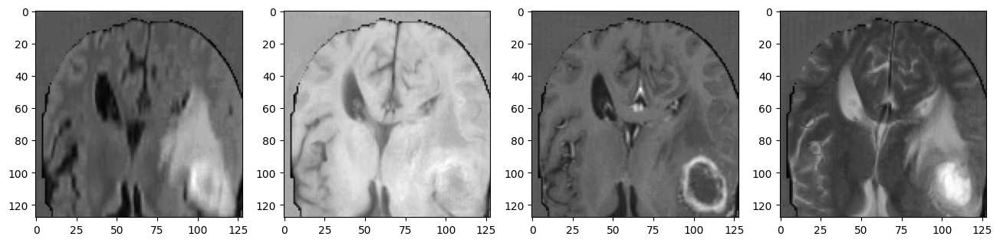

tensor(0.0632, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.307175159454346, Min:-2.631235361099243, Mean:0.03064875677227974, Std:0.8362467288970947
Shape: torch.Size([128, 128, 128]), Max: 5.233912467956543, Min:-3.896637201309204, Mean:0.01962895691394806, Std:0.7410972118377686
Shape: torch.Size([128, 128, 128]), Max: 6.262526988983154, Min:-3.2111880779266357, Mean:0.01863083802163601, Std:0.7509306073188782
Shape: torch.Size([128, 128, 128]), Max: 5.77616024017334, Min:-2.4425106048583984, Mean:0.04962529242038727, Std:0.8092949390411377


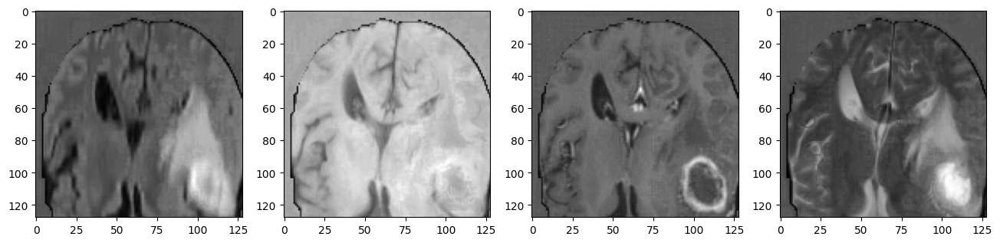

tensor(0.1218, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.385300159454346, Min:-2.709360361099243, Mean:0.03449377417564392, Std:0.8583269715309143
Shape: torch.Size([128, 128, 128]), Max: 5.312037467956543, Min:-3.974762201309204, Mean:0.022672373801469803, Std:0.740562915802002
Shape: torch.Size([128, 128, 128]), Max: 6.184401988983154, Min:-3.2893130779266357, Mean:0.013547749258577824, Std:0.7429533004760742
Shape: torch.Size([128, 128, 128]), Max: 5.85428524017334, Min:-2.5206356048583984, Mean:0.05389530211687088, Std:0.8213592767715454


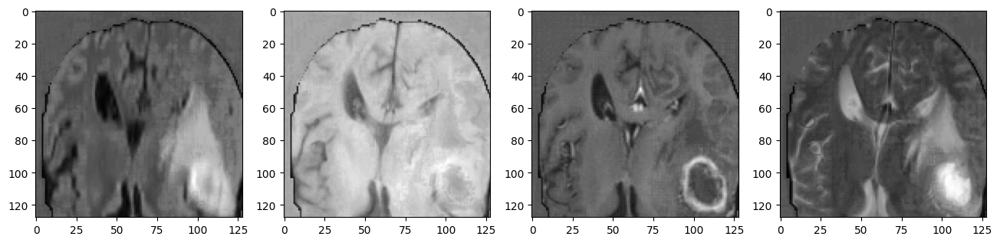

tensor(0.2093, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.463425159454346, Min:-2.787485361099243, Mean:0.03869106248021126, Std:0.8784600496292114
Shape: torch.Size([128, 128, 128]), Max: 5.233912467956543, Min:-4.052886962890625, Mean:0.014516670256853104, Std:0.7384276390075684
Shape: torch.Size([128, 128, 128]), Max: 6.106276988983154, Min:-3.3674380779266357, Mean:0.013738637790083885, Std:0.7390859127044678
Shape: torch.Size([128, 128, 128]), Max: 5.93241024017334, Min:-2.5987606048583984, Mean:0.05034568905830383, Std:0.8340431451797485


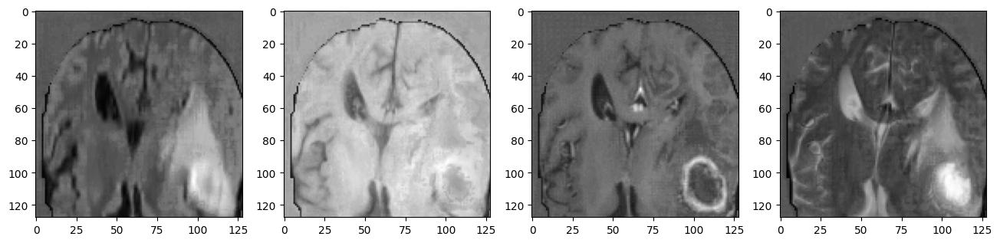

tensor(0.2944, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.541550159454346, Min:-2.865610361099243, Mean:0.04105222597718239, Std:0.895848274230957
Shape: torch.Size([128, 128, 128]), Max: 5.304943561553955, Min:-4.131011962890625, Mean:0.020980942994356155, Std:0.743925929069519
Shape: torch.Size([128, 128, 128]), Max: 6.135149955749512, Min:-3.4455630779266357, Mean:0.00951699074357748, Std:0.7361897826194763
Shape: torch.Size([128, 128, 128]), Max: 6.01053524017334, Min:-2.6768856048583984, Mean:0.053535059094429016, Std:0.8475590944290161


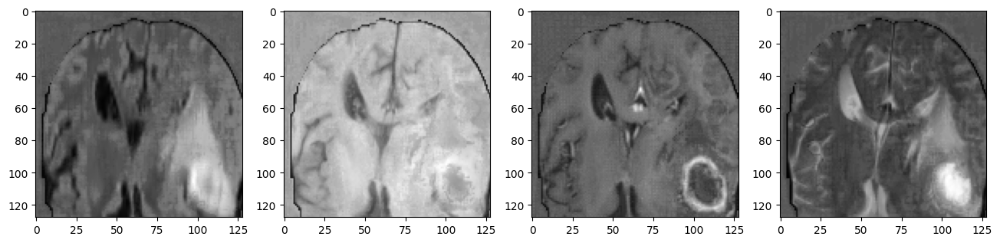

tensor(0.3765, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.619675159454346, Min:-2.943735361099243, Mean:0.044146452099084854, Std:0.9141271114349365
Shape: torch.Size([128, 128, 128]), Max: 5.226818561553955, Min:-4.209136962890625, Mean:0.01564609818160534, Std:0.7470391988754272
Shape: torch.Size([128, 128, 128]), Max: 6.160486698150635, Min:-3.5236880779266357, Mean:0.012175358831882477, Std:0.7356792092323303
Shape: torch.Size([128, 128, 128]), Max: 6.08866024017334, Min:-2.7550106048583984, Mean:0.05172404646873474, Std:0.8614717721939087


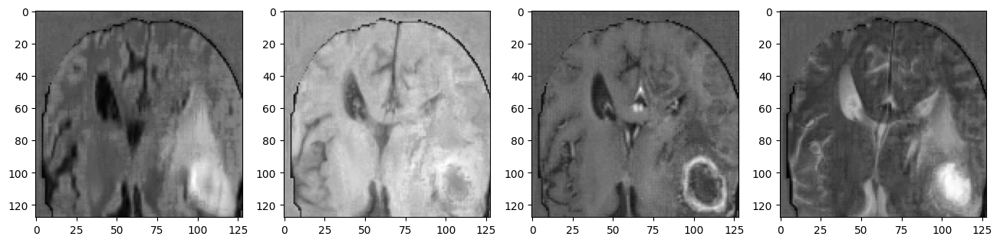

tensor(0.4498, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.697800159454346, Min:-3.021860361099243, Mean:0.04724157229065895, Std:0.9284162521362305
Shape: torch.Size([128, 128, 128]), Max: 5.148693561553955, Min:-4.287261962890625, Mean:0.019597817212343216, Std:0.7548864483833313
Shape: torch.Size([128, 128, 128]), Max: 6.238611698150635, Min:-3.6018130779266357, Mean:0.011046741157770157, Std:0.7373431921005249
Shape: torch.Size([128, 128, 128]), Max: 6.16678524017334, Min:-2.8331356048583984, Mean:0.05664579197764397, Std:0.8714948296546936


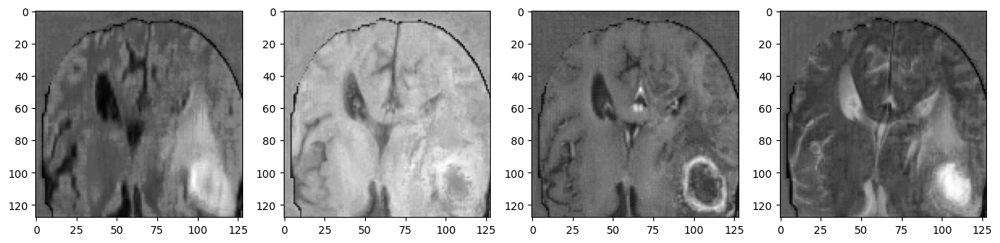

tensor(0.5053, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.775925159454346, Min:-3.099985361099243, Mean:0.053005266934633255, Std:0.9430356025695801
Shape: torch.Size([128, 128, 128]), Max: 5.1019415855407715, Min:-4.365386962890625, Mean:0.011507075279951096, Std:0.7606141567230225
Shape: torch.Size([128, 128, 128]), Max: 6.316736698150635, Min:-3.6799380779266357, Mean:0.015864664688706398, Std:0.7400363683700562
Shape: torch.Size([128, 128, 128]), Max: 6.24491024017334, Min:-2.9112606048583984, Mean:0.05076981708407402, Std:0.884191632270813


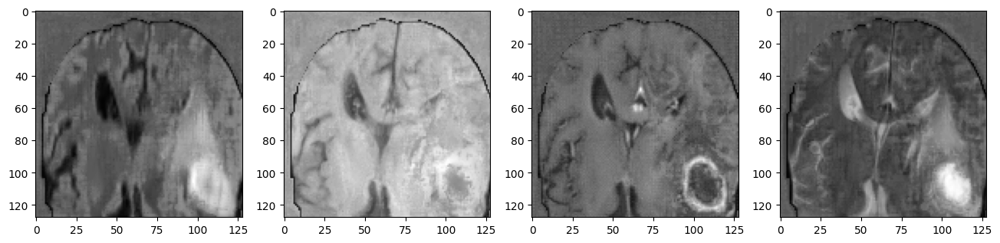

tensor(0.5577, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.854050159454346, Min:-3.178110361099243, Mean:0.05473477020859718, Std:0.9543141722679138
Shape: torch.Size([128, 128, 128]), Max: 5.1800665855407715, Min:-4.443511962890625, Mean:0.010971900075674057, Std:0.7698425054550171
Shape: torch.Size([128, 128, 128]), Max: 6.394861698150635, Min:-3.7580630779266357, Mean:0.014673983678221703, Std:0.7422195076942444
Shape: torch.Size([128, 128, 128]), Max: 6.32303524017334, Min:-2.9893856048583984, Mean:0.049303021281957626, Std:0.8958205580711365


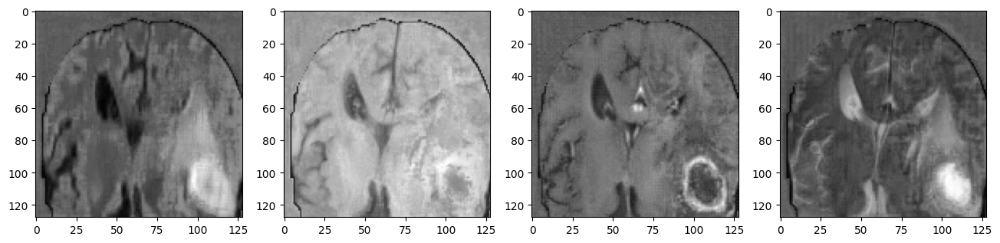

 62%|██████▎   | 5/8 [07:12<04:20, 86.96s/it]

torch.Size([1, 4, 128, 128, 128]) torch.Size([1, 1, 128, 128, 128])
START IMAGE: torch.Size([1, 4, 128, 128, 128])
START LABEL: torch.Size([1, 128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.1381) tensor(-2.3969) tensor(0.0234) tensor(0.7837)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(5.4683) tensor(-3.6623) tensor(0.0260) tensor(0.7358)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.2128) tensor(-2.9768) tensor(0.0174) tensor(0.7546)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(5.6358) tensor(-2.2081) tensor(0.0312) tensor(0.7875)
torch.Size([128, 128, 128])


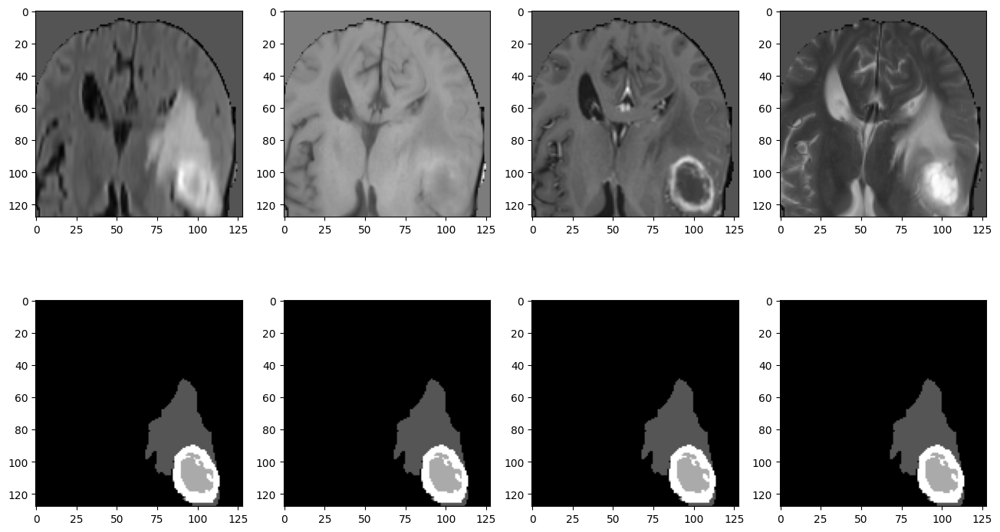

tensor(0.0163, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.150925159454346, Min:-2.474985361099243, Mean:0.01872378960251808, Std:0.7868947386741638
Shape: torch.Size([128, 128, 128]), Max: 5.390162467956543, Min:-3.740387201309204, Mean:0.03026696667075157, Std:0.749647319316864
Shape: torch.Size([128, 128, 128]), Max: 6.13472318649292, Min:-3.0549380779266357, Mean:0.019268380478024483, Std:0.757678747177124
Shape: torch.Size([128, 128, 128]), Max: 5.61991024017334, Min:-2.2862606048583984, Mean:0.03508113697171211, Std:0.7858622074127197


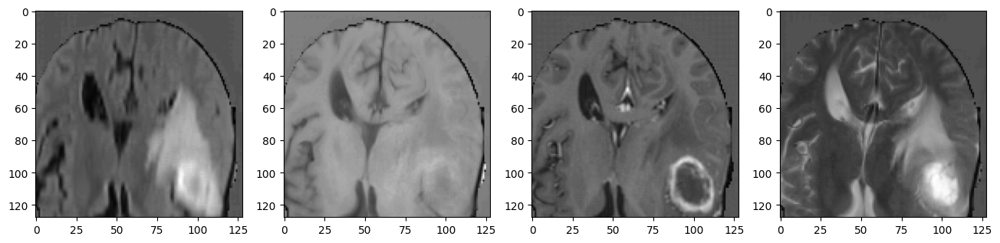

tensor(0.0304, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.229050159454346, Min:-2.553110361099243, Mean:0.015689987689256668, Std:0.7914909720420837
Shape: torch.Size([128, 128, 128]), Max: 5.312037467956543, Min:-3.818512201309204, Mean:0.029036056250333786, Std:0.757353663444519
Shape: torch.Size([128, 128, 128]), Max: 6.05659818649292, Min:-3.1330630779266357, Mean:0.021458260715007782, Std:0.7527480125427246
Shape: torch.Size([128, 128, 128]), Max: 5.69803524017334, Min:-2.3643856048583984, Mean:0.025170600041747093, Std:0.7901411652565002


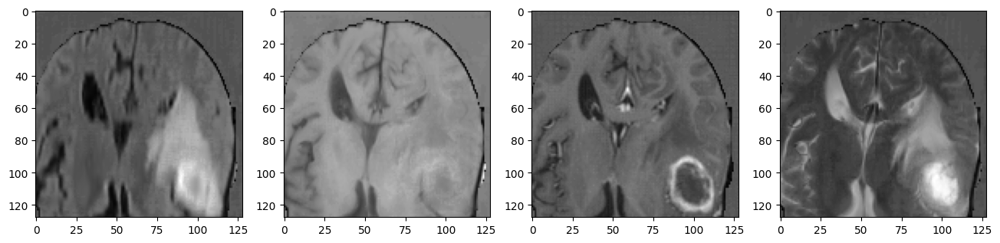

tensor(0.0545, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.307175159454346, Min:-2.631235361099243, Mean:0.007226797752082348, Std:0.796874463558197
Shape: torch.Size([128, 128, 128]), Max: 5.390162467956543, Min:-3.896637201309204, Mean:0.030685314908623695, Std:0.7655000686645508
Shape: torch.Size([128, 128, 128]), Max: 5.97847318649292, Min:-3.2111880779266357, Mean:0.018587030470371246, Std:0.746306300163269
Shape: torch.Size([128, 128, 128]), Max: 5.77616024017334, Min:-2.4425106048583984, Mean:0.01825050078332424, Std:0.7937449216842651


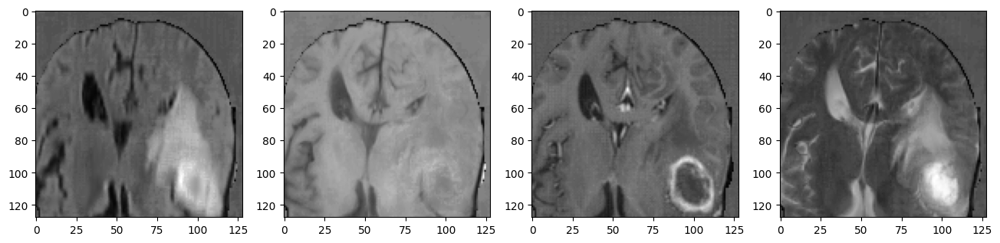

tensor(0.0903, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.385300159454346, Min:-2.709360361099243, Mean:-0.003310411237180233, Std:0.8026644587516785
Shape: torch.Size([128, 128, 128]), Max: 5.468287467956543, Min:-3.974762201309204, Mean:0.037621356546878815, Std:0.7721096277236938
Shape: torch.Size([128, 128, 128]), Max: 5.90034818649292, Min:-3.2893130779266357, Mean:0.014239911921322346, Std:0.7395621538162231
Shape: torch.Size([128, 128, 128]), Max: 5.85428524017334, Min:-2.5206356048583984, Mean:0.011659270152449608, Std:0.797748327255249


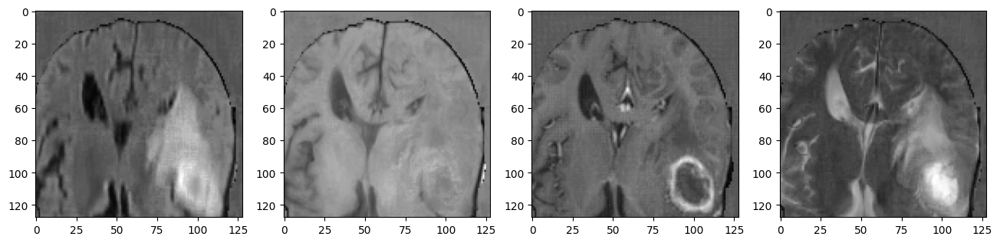

tensor(0.1371, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.307175159454346, Min:-2.787485361099243, Mean:-0.008625506423413754, Std:0.8088573217391968
Shape: torch.Size([128, 128, 128]), Max: 5.546412467956543, Min:-4.052886962890625, Mean:0.033223651349544525, Std:0.7725440859794617
Shape: torch.Size([128, 128, 128]), Max: 5.82222318649292, Min:-3.3674380779266357, Mean:0.017184752970933914, Std:0.7356418967247009
Shape: torch.Size([128, 128, 128]), Max: 5.93241024017334, Min:-2.5987606048583984, Mean:0.0016477014869451523, Std:0.8044179081916809


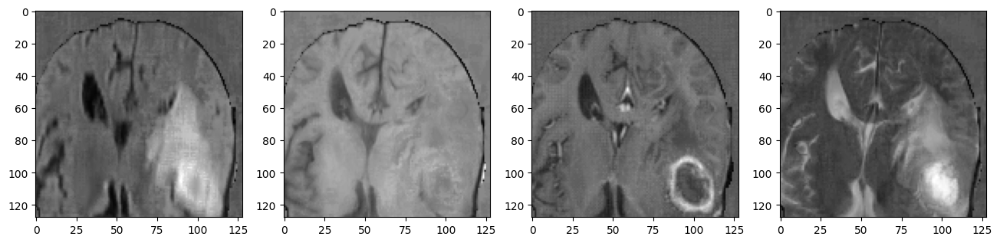

tensor(0.2017, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.3293023109436035, Min:-2.865610361099243, Mean:-0.017550550401210785, Std:0.8133217692375183
Shape: torch.Size([128, 128, 128]), Max: 5.624537467956543, Min:-4.131011962890625, Mean:0.040874361991882324, Std:0.7812223434448242
Shape: torch.Size([128, 128, 128]), Max: 5.74409818649292, Min:-3.4455630779266357, Mean:0.010735752992331982, Std:0.7298235297203064
Shape: torch.Size([128, 128, 128]), Max: 6.01053524017334, Min:-2.6768856048583984, Mean:-0.0023177210241556168, Std:0.8098164796829224


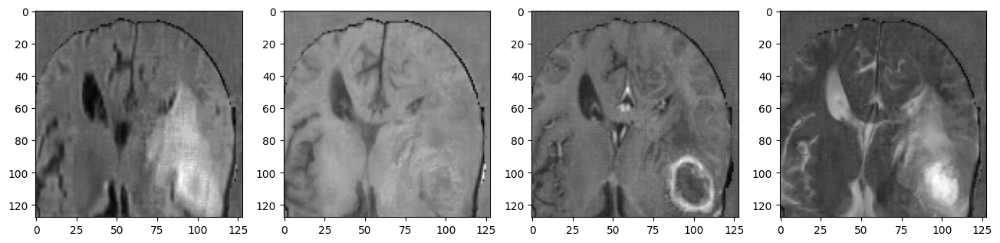

tensor(0.2835, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.4074273109436035, Min:-2.943735361099243, Mean:-0.020943470299243927, Std:0.8239403367042542
Shape: torch.Size([128, 128, 128]), Max: 5.702662467956543, Min:-4.209136962890625, Mean:0.0404738187789917, Std:0.7836514115333557
Shape: torch.Size([128, 128, 128]), Max: 5.806658744812012, Min:-3.5236880779266357, Mean:0.015620649792253971, Std:0.725812554359436
Shape: torch.Size([128, 128, 128]), Max: 6.08866024017334, Min:-2.7550106048583984, Mean:-0.010904369875788689, Std:0.8201696276664734


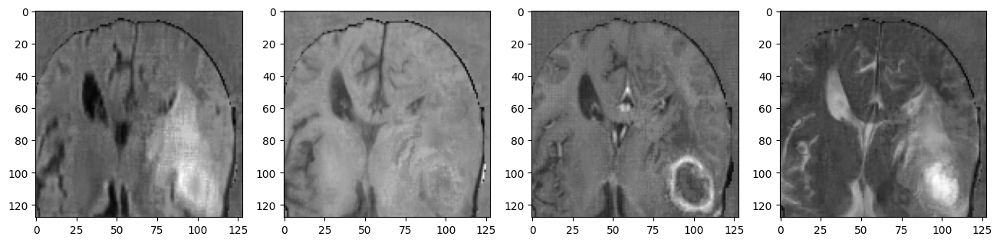

tensor(0.3917, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.4855523109436035, Min:-3.021860361099243, Mean:-0.028499707579612732, Std:0.8341500759124756
Shape: torch.Size([128, 128, 128]), Max: 5.780787467956543, Min:-4.287261962890625, Mean:0.047869786620140076, Std:0.7896541953086853
Shape: torch.Size([128, 128, 128]), Max: 5.728533744812012, Min:-3.6018130779266357, Mean:0.01452325377613306, Std:0.7209867835044861
Shape: torch.Size([128, 128, 128]), Max: 6.16678524017334, Min:-2.8331356048583984, Mean:-0.011642122641205788, Std:0.8280841708183289


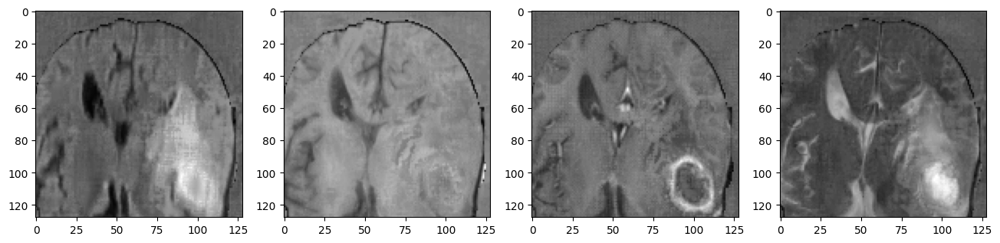

tensor(0.5185, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.5636773109436035, Min:-3.099985361099243, Mean:-0.03285576403141022, Std:0.8424025177955627
Shape: torch.Size([128, 128, 128]), Max: 5.858912467956543, Min:-4.365386962890625, Mean:0.04937539994716644, Std:0.7947673201560974
Shape: torch.Size([128, 128, 128]), Max: 5.762363910675049, Min:-3.6799380779266357, Mean:0.018393686041235924, Std:0.7194981575012207
Shape: torch.Size([128, 128, 128]), Max: 6.24491024017334, Min:-2.9112606048583984, Mean:-0.01627913862466812, Std:0.836540699005127


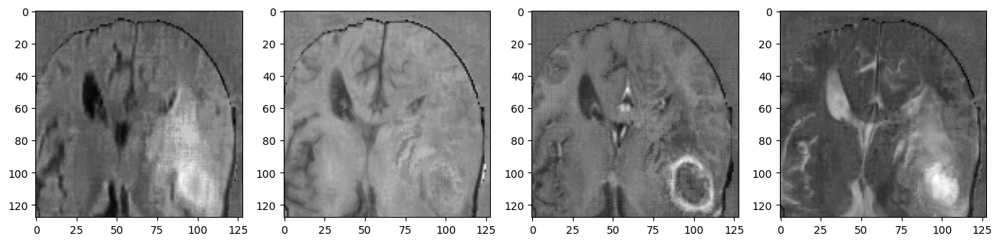

tensor(0.6561, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.6418023109436035, Min:-3.178110361099243, Mean:-0.038558438420295715, Std:0.850114643573761
Shape: torch.Size([128, 128, 128]), Max: 5.780787467956543, Min:-4.443511962890625, Mean:0.05690853297710419, Std:0.799298107624054
Shape: torch.Size([128, 128, 128]), Max: 5.840488910675049, Min:-3.7580630779266357, Mean:0.018148260191082954, Std:0.7197100520133972
Shape: torch.Size([128, 128, 128]), Max: 6.32303524017334, Min:-2.9893856048583984, Mean:-0.01543513685464859, Std:0.8411393761634827


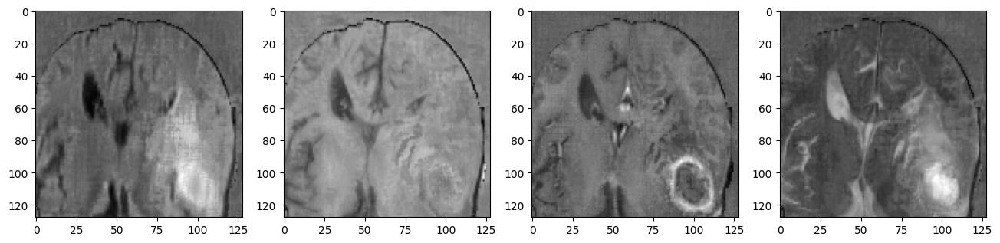

 75%|███████▌  | 6/8 [08:41<02:55, 87.76s/it]

torch.Size([1, 4, 128, 128, 128]) torch.Size([1, 1, 128, 128, 128])
START IMAGE: torch.Size([1, 4, 128, 128, 128])
START LABEL: torch.Size([1, 128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.1381) tensor(-2.3969) tensor(0.0233) tensor(0.7675)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.4906) tensor(-3.6623) tensor(0.0033) tensor(0.7219)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(6.0323) tensor(-2.9768) tensor(0.0125) tensor(0.7284)
torch.Size([128, 128, 128])
torch.Size([128, 128, 128]) tensor(5.6358) tensor(-2.2081) tensor(0.0185) tensor(0.7685)
torch.Size([128, 128, 128])


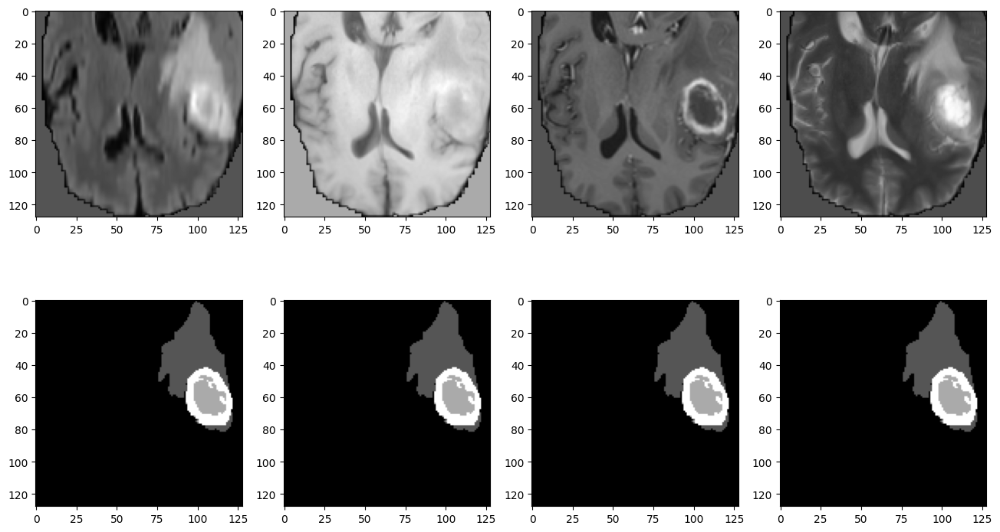

tensor(0.0176, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.150925159454346, Min:-2.474985361099243, Mean:0.017442889511585236, Std:0.7703954577445984
Shape: torch.Size([128, 128, 128]), Max: 6.568770408630371, Min:-3.740387201309204, Mean:0.0018338123336434364, Std:0.7268843650817871
Shape: torch.Size([128, 128, 128]), Max: 6.110381603240967, Min:-3.0549380779266357, Mean:0.020333178341388702, Std:0.738770604133606
Shape: torch.Size([128, 128, 128]), Max: 5.557655334472656, Min:-2.2862606048583984, Mean:0.026446184143424034, Std:0.7678505778312683


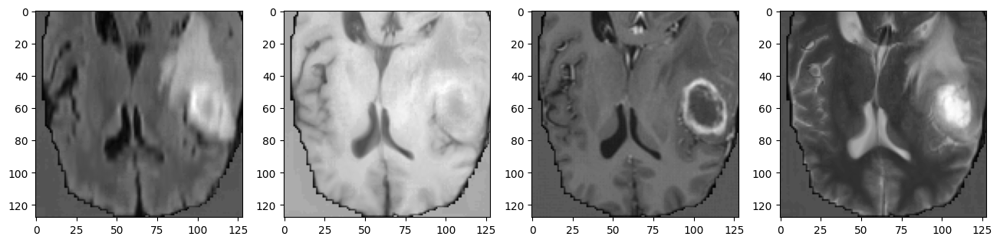

tensor(0.0312, grad_fn=<NllLoss2DBackward0>)
Shape: torch.Size([128, 128, 128]), Max: 6.229050159454346, Min:-2.553110361099243, Mean:0.019982486963272095, Std:0.7679228186607361
Shape: torch.Size([128, 128, 128]), Max: 6.646895408630371, Min:-3.818512201309204, Mean:-0.004906433634459972, Std:0.7350539565086365
Shape: torch.Size([128, 128, 128]), Max: 6.032256603240967, Min:-3.1330630779266357, Mean:0.022996388375759125, Std:0.7395083904266357
Shape: torch.Size([128, 128, 128]), Max: 5.479530334472656, Min:-2.3643856048583984, Mean:0.026437168940901756, Std:0.7663018107414246


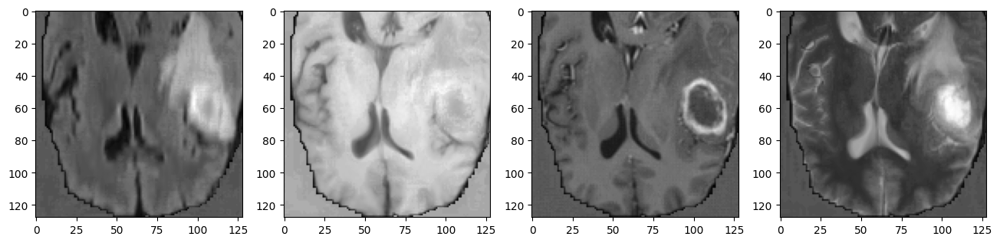

 75%|███████▌  | 6/8 [09:02<03:00, 90.41s/it]


KeyboardInterrupt: 

In [ ]:
for lists in list_of_lists_or_source_folder:
    # print(file)
    # # x_nat = load_nii_data(os.path.join(input_path, file))
    # x_nat, props_x = SimpleITKIO().read_images([join(input_path, f'{file}')])
    # # y = load_nii_data(os.path.join(label_path, file[:-12] + '.nii.gz'))
    # y, props_y = SimpleITKIO().read_images([join(label_path, f'{file[:-12]}' + '.nii.gz')])
    # print(x_nat.shape, y.shape, props_x, props_y, sep='\n')

    preprocessor = configuration_manager.preprocessor_class(verbose=True)

    data, seg, data_properties = preprocessor.run_case(list_of_lists_or_source_folder[0],
                                                               None,
                                                               plans_manager,
                                                               configuration_manager,
                                                               dataset_json)
    print(data.shape, seg.shape)
    data = torch.from_numpy(data).to(dtype=torch.float32, memory_format=torch.contiguous_format)
    print(data.shape)
    item = {'data': data, 'data_properties': data_properties, 'ofile': None}

    prediction = None
    # prediction = network(data)
    # print(prediction.shape)

    if prediction is None:
        prediction = predict_sliding_window_return_logits(network=network, input_label=y, input_image=data).to('cpu')
    else:
        prediction += predict_sliding_window_return_logits(data).to('cpu')
    
    print(prediction.shape)

    export_prediction_from_logits((prediction, properties, configuration_manager, plans_manager,
                              dataset_json, ofile, save_probabilities))
    # Perform PGD attack
    # x_adv_pgd = pgd_attacker.perturb(x_nat, y, props_x, pgd_file=join(pgd_path, f'{file}'))
    # x_adv.append(x_adv_pgd)
    break

In [ ]:
scheme = configuration_manager.normalization_schemes[0]
scheme

'ZScoreNormalization'

In [ ]:
from nnunetv2.inference.predict_from_raw_data import nnUNetPredictor

predictor = nnUNetPredictor(
    tile_step_size=0.5,
    use_gaussian=True,
    use_mirroring=True,
    perform_everything_on_device=False,
    device=torch.device('cpu'),
    verbose=True,
    verbose_preprocessing=False,
    allow_tqdm=True
)
predictor.initialize_from_trained_model_folder(
    r'U:\YCZhang\Dissertation\data\.bash_history',
    use_folds=(0,),
    checkpoint_name='checkpoint_final.pth',
)
predictor.predict_from_files(r'U:\YCZhang\Dissertation\data\.bash_history\imagesTs',
                                r'U:\YCZhang\Dissertation\data\.bash_history\inferTs',
                                save_probabilities=False, overwrite=False,
                                num_processes_preprocessing=2, num_processes_segmentation_export=2,
                                folder_with_segs_from_prev_stage=None, num_parts=1, part_id=0)

perform_everything_on_device=True is only supported for cuda devices! Setting this to False
There are 313 cases in the source folder
I am process 0 out of 1 (max process ID is 0, we start counting with 0!)
There are 313 cases that I would like to predict
overwrite was set to False, so I am only working on cases that haven't been predicted yet. That's 313 cases.


KeyboardInterrupt: 